<div style="display: flex; background-color: RGB(255,114,0);" >
<h1 style="margin: auto; padding: 30px; ">Projet 9 : Analysez les ventes d'une librairie avec R ou Python</h1>
</div>

### Index

* [Etape 1 - Importation des librairies et chargement des fichiers](#chapter1)
    * [1.1 - Importation des librairies](#section_1_1)
    * [1.2 - Chargements des fichiers](#section_1_2)

* [Etape 2 - Exploration des données](#chapter2)
    * [2.1 - Données df_clients ](#section_2_1)
    * [2.2 - Données df_produits](#section_2_2)
    * [2.3 - Données df_transactions](#section_2_3)

* [Etape 4 - Jonction des fichiers](#chapter4)
    * [4.1 - Réalisation de la jointure entre df_clients et df_transactions ](#section_4_1)
    * [4.2 - Réalisation de la jointure entre df_merge et df_produits](#section_4_2)

* [Etape 5 - Études du chiffre d'affaires](#chapter5)
    * [5.1 - Evolution du chiffre d'affaires journalier](#section_5_1)
    * [5.2 - Evolution du chiffre d'affaires mensuel et détails par catégories](#section_5_2)    
    * [5.3 - Evolution du chiffre d'affaires cumulés](#section_5_3)
    * [5.4 - Total chiffres d'affaires par catégories](#section_5_4)
    * [5.5 - Courbe de Lorenz et coeff de gini](#section_5_5)

* [Etape 6 - Chiffres d'affaires par clients et definition des clients B2B](#chapter6)

    * [6.1 - Distribution du CA par clients](#section_6_1)
    * [6.2 - Courbe de Lorenz et coeff de gini](#section_6_2)
    * [6.3 - Top 10 des clients par chiffre d'affaires total et détails pour chaques catégories](#section_6_3)
    * [6.4 - Definition des clients Outlier par le CA (methode IQR)](#section_6_4)
    * [6.5 - Definition des clients Outlier par le CA (methode Zscore)](#section_6_5)
    * [6.6 - Exclusion des 4 clients B2B](#section_6_6)
    * [6.7 - Répartition du chiffre d'affaires entre clients et B2B et détails des catégories pour les B2B](#section_6_7)
    * [6.8 - Top 10 des clients par chiffre d'affaires total et détails pour chaques catégories (clients B2B exclus)](#section_6_8)
    * [6.9 - 80/20 en Chiffre d'Affaires (Analyse de Pareto)](#section_6_9)

* [Etape 7 - Indicateurs de ventes (KPI's)](#chapter7)

    * [7.1 - Nombre de transactions par clients et par categories](#section_7_1)
    * [7.2 - Evolution du nombre de transactions(mensuel)](#section_7_2)
    * [7.3 - Nombre de Sessions par clients](#section_7_3)
    * [7.4 - Panier_Moyen par clients](#section_7_4)
    * [7.5 - Evolution du nombre de clients (mensuel)](#section_7_5)
    * [7.6 - Nombre de références vendus par mois](#section_7_6)
    * [7.7 - Tops et Flops Références Vendues par An](#section_7_7)

* [Etape 8 - Etudes des relations demandées](#chapter8)
    * [8.1 Préparation de la matrice pour les études des relations](#section_8_1)
    * [8.2 Lien entre le genre d’un client et les catégories des livres achetés](#section_8_2)
    * [8.3 Lien entre l'âge des clients et le montant total des achats](#section_8_3)
    * [8.4 Lien entre l'âge des clients et la fréquence d’achats](#section_8_4)
    * [8.5 Lien entre l'âge des clients et la taille du panier moyen](#section_8_5)
    * [8.6 Lien entre l'âge des clients et la catégorie des livres achetés](#section_8_6)


<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 1 - Importation des librairies et chargement des fichiers</h2>
<a class="anchor" id="chapter1"></a>
</div>

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">1.1 - Importation des librairies</h3>
<a class="anchor" id="section_1_1"></a>
</div>

In [1]:
#Import de la bibliothèque Pandas
import pandas as pd
# Ajuster les options d'affichage
pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', None)

In [2]:
#Import de la bibliothèque plotly express
import plotly.express as px

In [3]:
#Import de la bibliothèque matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

In [4]:
# Import bibliothèque Numpy
import numpy as np

In [5]:
# Import de la bibliothèque Seaborn
import seaborn as sns

In [6]:
# Import de la bibliothèque Datetime
from datetime import datetime

In [7]:
#Import de la bibliothèque scipy et import des tests statistiques
import scipy
from scipy.stats import chi2_contingency, pearsonr, levene, shapiro, chi2, f_oneway

In [8]:
#Import de la bibliothèque statsmodels
from statsmodels.formula.api import ols
import statsmodels.api as sm
import statsmodels.stats.anova as anova
import statsmodels.graphics.gofplots as gofplots

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">1.2 - Chargements des fichiers</h3>
<a class="anchor" id="section_1_2"></a>
</div>

In [9]:
#Import du fichier customers.csv
df_clients = pd.read_csv('C:\\Users\\WadJa\\Desktop\\Openclassroom\\Projet 9\\Data\\customers.csv', sep=';')

#Import du fichier products.csv
df_produits = pd.read_csv('C:\\Users\\WadJa\\Desktop\\Openclassroom\\Projet 9\\Data\\products.csv', sep=';', dtype={'categ': object})

#Import du fichier Transactions.csv
df_transactions = pd.read_csv(
    'C:\\Users\\WadJa\\Desktop\\Openclassroom\\Projet 9\\Data\\Transactions.csv', sep=';',dtype={
        'id_prod': 'object',
        'session_id': 'object',
        'client_id': 'object'},
    parse_dates=['date']
)

<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 2 - Exploration et Analyse </h2>
<a class="anchor" id="chapter2"></a>
</div>

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">2.1 - Données df_clients</h3>
<a class="anchor" id="section_2_1"></a>
</div>

In [10]:
df_clients.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8621 entries, 0 to 8620
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   client_id  8621 non-null   object
 1   sex        8621 non-null   object
 2   birth      8621 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 202.2+ KB


In [11]:
df_clients.describe(include = 'all')

,client_id,sex,birth
count,8621,8621,8621.000000
unique,8621,2,NaN
top,c_4410,f,NaN
freq,1,4490,NaN
mean,NaN,NaN,1978.275606
std,NaN,NaN,16.917958
min,NaN,NaN,1929.000000
25%,NaN,NaN,1966.000000
50%,NaN,NaN,1979.000000
75%,NaN,NaN,1992.000000


In [12]:
# Remplacer 'm' par 'Homme' et 'f' par 'Femme' dans la colonne 'sex'
df_clients['sex'] = df_clients['sex'].replace({'m': 'Homme', 'f': 'Femme'})

In [13]:
# Calculer l'âge
df_clients['age'] = datetime.now().year - df_clients['birth']


In [14]:
df_clients.head()

,client_id,sex,birth,age
0,c_4410,Femme,1967,57
1,c_7839,Femme,1975,49
2,c_1699,Femme,1984,40
3,c_5961,Femme,1962,62
4,c_5320,Homme,1943,81


In [15]:
#Suppression de la colonne 'birth'
df_clients = df_clients.drop('birth', axis=1)

In [16]:
df_clients

,client_id,sex,age
0,c_4410,Femme,57
1,c_7839,Femme,49
2,c_1699,Femme,40
3,c_5961,Femme,62
4,c_5320,Homme,81
...,...,...,...
8616,c_7920,Homme,68
8617,c_7403,Femme,54
8618,c_5119,Homme,50
8619,c_5643,Femme,56


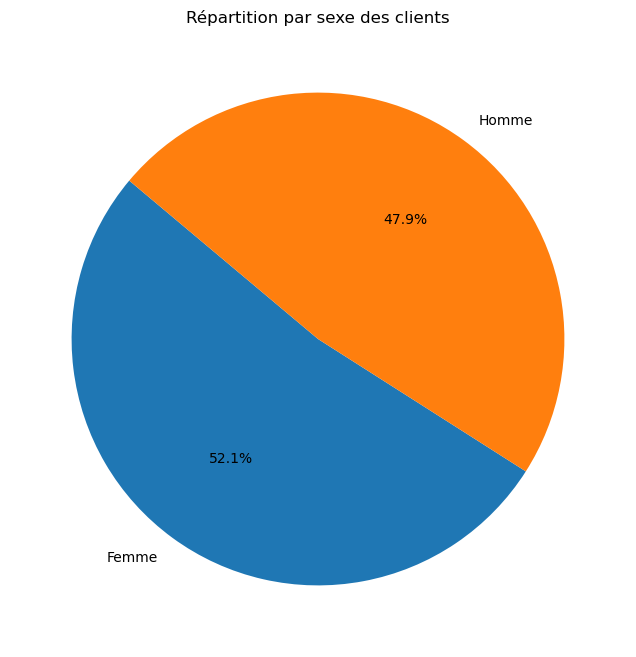

In [17]:
# Analyse de la répartition du sex

distribution_sex = df_clients['sex'].value_counts()

plt.figure(figsize=(8, 8))  
plt.pie(distribution_sex, labels=distribution_sex.index, autopct='%1.1f%%', startangle=140)
plt.title('Répartition par sexe des clients')
plt.show()


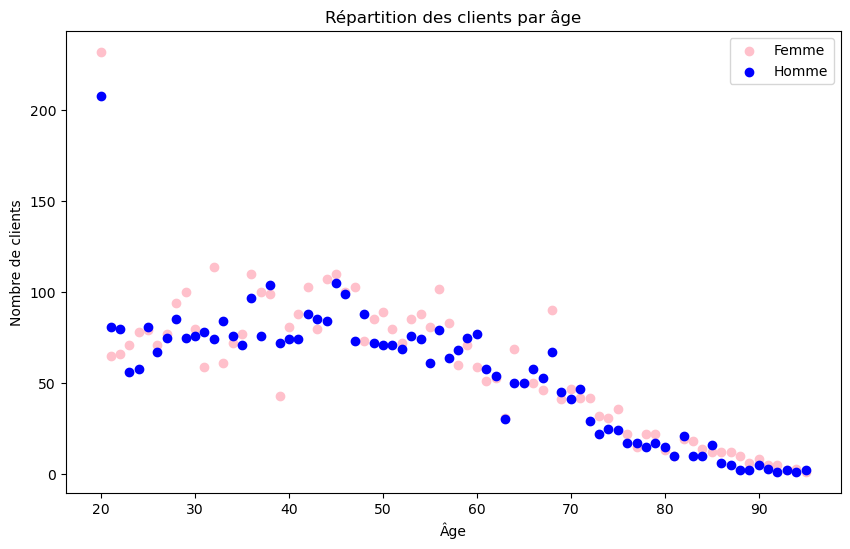

In [18]:
# Calculer le nombre de clients par âge et sexe
grouped_data = df_clients.groupby(['age', 'sex']).size().reset_index(name='count')

# Séparation des données par sexe
data_femme = grouped_data[grouped_data['sex'] == 'Femme']
data_homme = grouped_data[grouped_data['sex'] == 'Homme']

# Création du nuage de points
plt.figure(figsize=(10, 6))
plt.scatter(data_femme['age'], data_femme['count'], color='pink', label='Femme')
plt.scatter(data_homme['age'], data_homme['count'], color='blue', label='Homme')

plt.xlabel('Âge')
plt.ylabel('Nombre de clients')
plt.title('Répartition des clients par âge')
plt.legend()
plt.show()



<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">2.2 - Données df_produits</h3>
<a class="anchor" id="section_2_2"></a>
</div>

In [19]:
df_produits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3286 entries, 0 to 3285
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   id_prod  3286 non-null   object 
 1   price    3286 non-null   float64
 2   categ    3286 non-null   object 
dtypes: float64(1), object(2)
memory usage: 77.1+ KB


In [20]:
df_produits.describe(include = 'all')

,id_prod,price,categ
count,3286,3286.000000,3286
unique,3286,NaN,3
top,0_1421,NaN,0
freq,1,NaN,2308
mean,NaN,21.863597,NaN
std,NaN,29.849786,NaN
min,NaN,0.620000,NaN
25%,NaN,6.990000,NaN
50%,NaN,13.075000,NaN
75%,NaN,22.990000,NaN


In [21]:
# Analyse de la répartition des prix produits

fig = px.histogram(df_produits, x='price', title='Distribution des prix des produits')
fig.update_layout(bargap=0.2) 

fig.show()

In [22]:
# Création d'un boxplot de la distribution des prix des produits par catégories
fig = px.box(df_produits, x='categ', y='price', color='categ',
             title='Distribution des prix par catégories')
fig.update_layout(xaxis_title='Catégorie', yaxis_title='Prix')

fig.show()


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">2.3 - Données df_transactions</h3>
<a class="anchor" id="section_2_3"></a>
</div>
 

In [23]:
df_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   id_prod     687534 non-null  object        
 1   date        687534 non-null  datetime64[ns]
 2   session_id  687534 non-null  object        
 3   client_id   687534 non-null  object        
dtypes: datetime64[ns](1), object(3)
memory usage: 32.0+ MB


In [24]:
#RangeIndex: 1048575 entries / 687534 non-nul
#Suppression des lignes où toutes les colonnes sont nulles
df_transactions = df_transactions.dropna(how='all')

In [25]:
#Vérification
df_transactions.info()

<class 'pandas.core.frame.DataFrame'>
Index: 687534 entries, 0 to 687533
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   id_prod     687534 non-null  object        
 1   date        687534 non-null  datetime64[ns]
 2   session_id  687534 non-null  object        
 3   client_id   687534 non-null  object        
dtypes: datetime64[ns](1), object(3)
memory usage: 26.2+ MB


In [26]:
df_transactions.describe(include = 'all')

,id_prod,date,session_id,client_id
count,687534,687534,687534,687534
unique,3265,NaN,345505,8600
top,1_369,NaN,s_118668,c_1609
freq,2340,NaN,14,25586
mean,NaN,2022-03-01 21:24:00.618519296,NaN,NaN
min,NaN,2021-03-01 00:01:07.843138,NaN,NaN
25%,NaN,2021-09-10 10:35:20.642323456,NaN,NaN
50%,NaN,2022-02-27 06:50:25.400120064,NaN,NaN
75%,NaN,2022-08-28 22:16:49.841665536,NaN,NaN
max,NaN,2023-02-28 23:58:30.792755,NaN,NaN


In [27]:
df_transactions

,id_prod,date,session_id,client_id
0,0_1259,2021-03-01 00:01:07.843138,s_1,c_329
1,0_1390,2021-03-01 00:02:26.047414,s_2,c_664
2,0_1352,2021-03-01 00:02:38.311413,s_3,c_580
3,0_1458,2021-03-01 00:04:54.559692,s_4,c_7912
4,0_1358,2021-03-01 00:05:18.801198,s_5,c_2033
...,...,...,...,...
687529,1_508,2023-02-28 23:49:03.148402,s_348444,c_3573
687530,2_37,2023-02-28 23:51:29.318531,s_348445,c_50
687531,1_695,2023-02-28 23:53:18.929676,s_348446,c_488
687532,0_1547,2023-02-28 23:58:00.107815,s_348447,c_4848


<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 4 - Jonction des fichiers</h2>
<a class="anchor" id="chapter4"></a>
</div>

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">4.1 Réalisation de la jointure entre df_clients et df_transactions</h3>
<a class="anchor" id="section_4_1"></a>
</div>

In [28]:
df_merge= pd.merge(df_clients, df_transactions, how="inner", on='client_id')

# Affichage du DataFrame résultant pour vérification
df_merge.head(10)


,client_id,sex,age,id_prod,date,session_id
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092
5,c_4410,Femme,57,0_521,2021-03-23 17:11:46.158290,s_10454
6,c_4410,Femme,57,1_407,2021-03-24 18:30:13.156928,s_10922
7,c_4410,Femme,57,0_1587,2021-04-25 09:06:27.525631,s_25473
8,c_4410,Femme,57,1_584,2021-05-28 05:19:16.367701,s_40563
9,c_4410,Femme,57,1_91,2021-05-28 05:29:10.024293,s_40563


In [29]:
df_merge.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 687534 entries, 0 to 687533
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   client_id   687534 non-null  object        
 1   sex         687534 non-null  object        
 2   age         687534 non-null  int64         
 3   id_prod     687534 non-null  object        
 4   date        687534 non-null  datetime64[ns]
 5   session_id  687534 non-null  object        
dtypes: datetime64[ns](1), int64(1), object(4)
memory usage: 31.5+ MB


In [30]:
# Vérifier le nombre d'entrées uniques de `client_id` dans df_merge
print("Nombre id_client uniques dans df_merge:", df_merge['client_id'].nunique())

# Vérifier le nombre d'entrées uniques de `client_id` dans df_clients
print("Nombre id_client uniques dans df_clients:", df_clients['client_id'].nunique())

# Vérifier le nombre d'entrées uniques de `client_id` dans df_transactions
print("Nombre id_client uniques dans df_transactions:", df_transactions['client_id'].nunique())

Nombre id_client uniques dans df_merge: 8600
Nombre id_client uniques dans df_clients: 8621
Nombre id_client uniques dans df_transactions: 8600


In [31]:
print((df_clients['client_id'].nunique())-(df_transactions['client_id'].nunique()),"clients n'ont jamais passés de commande")

21 clients n'ont jamais passés de commande


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">4.2 Réalisation de la jointure entre df_merge et df_produits </h3>
<a class="anchor" id="section_4_2"></a>
</div>

In [32]:
df_lapage = pd.merge(df_merge, df_produits,how="inner", on='id_prod')

df_lapage

,client_id,sex,age,id_prod,date,session_id,price,categ
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0
...,...,...,...,...,...,...,...,...
687529,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0
687530,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0
687531,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1
687532,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0


In [33]:
# Vérifier le nombre d'entrées uniques de `client_id` dans df_merge
print("Nombre d'entrées uniques de `id_prod` dans df_merge:", df_lapage['id_prod'].nunique())

# Vérifier le nombre d'entrées uniques de `client_id` dans df_lapage
print("Nombre d'entrées uniques de `id_prod` df_lapage:", df_merge['id_prod'].nunique())

Nombre d'entrées uniques de `id_prod` dans df_merge: 3265
Nombre d'entrées uniques de `id_prod` df_lapage: 3265


Chaques références produits a été achetées au moins une fois.

In [34]:
df_lapage.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 687534 entries, 0 to 687533
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   client_id   687534 non-null  object        
 1   sex         687534 non-null  object        
 2   age         687534 non-null  int64         
 3   id_prod     687534 non-null  object        
 4   date        687534 non-null  datetime64[ns]
 5   session_id  687534 non-null  object        
 6   price       687534 non-null  float64       
 7   categ       687534 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(1), object(5)
memory usage: 42.0+ MB


In [35]:
df_lapage.describe(include='all')

,client_id,sex,age,id_prod,date,session_id,price,categ
count,687534,687534,687534.000000,687534,687534,687534,687534.000000,687534
unique,8600,2,NaN,3265,NaN,345505,NaN,3
top,c_1609,Homme,NaN,1_369,NaN,s_118668,NaN,0
freq,25586,344841,NaN,2340,NaN,14,NaN,415459
mean,NaN,NaN,46.182609,NaN,2022-03-01 21:24:00.618518528,NaN,17.493918,NaN
min,NaN,NaN,20.000000,NaN,2021-03-01 00:01:07.843138,NaN,0.620000,NaN
25%,NaN,NaN,37.000000,NaN,2021-09-10 10:35:20.642323456,NaN,8.990000,NaN
50%,NaN,NaN,44.000000,NaN,2022-02-27 06:50:25.400120064,NaN,13.990000,NaN
75%,NaN,NaN,54.000000,NaN,2022-08-28 22:16:49.841665536,NaN,19.080000,NaN
max,NaN,NaN,95.000000,NaN,2023-02-28 23:58:30.792755,NaN,300.000000,NaN


<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 5 - Études du chiffre d'affaires
<a class="anchor" id="chapter5"></a>
</div>

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">5.1 - Evolution du chiffre d'affaires journalier</h3>
<a class="anchor" id="section_5_1"></a>
</div>

In [36]:
#Création d'une copie du df avec la colonne 'date' comme index 

df_Dateindex = df_lapage.copy()

df_Dateindex.set_index('date', inplace=True)
df_Dateindex

,client_id,sex,age,id_prod,session_id,price,categ
date,,,,,,,
2021-03-13 21:35:55.949042,c_4410,Femme,57,1_483,s_5913,15.99,1
2021-03-22 01:27:49.480137,c_4410,Femme,57,0_1111,s_9707,19.99,0
2021-03-22 01:40:22.782925,c_4410,Femme,57,1_385,s_9707,25.99,1
2021-03-22 14:29:25.189266,c_4410,Femme,57,0_1455,s_9942,8.99,0
2021-03-22 22:31:25.825764,c_4410,Femme,57,0_1420,s_10092,11.53,0
...,...,...,...,...,...,...,...
2022-05-14 00:24:49.391917,c_84,Femme,42,0_1472,s_208110,12.49,0
2022-05-29 06:11:50.316631,c_84,Femme,42,0_1438,s_215697,9.31,0
2022-12-17 00:16:56.629536,c_84,Femme,42,1_459,s_313173,15.99,1


In [37]:
df_CA_journalier = df_Dateindex.groupby(df_Dateindex.index.date)['price'].sum()
df_CA_journalier

2021-03-01    16565.22
2021-03-02    15486.45
2021-03-03    15198.69
2021-03-04    15196.07
2021-03-05    17471.37
                ...   
2023-02-24    15207.89
2023-02-25    15761.25
2023-02-26    16304.72
2023-02-27    19170.81
2023-02-28    18105.15
Name: price, Length: 730, dtype: float64

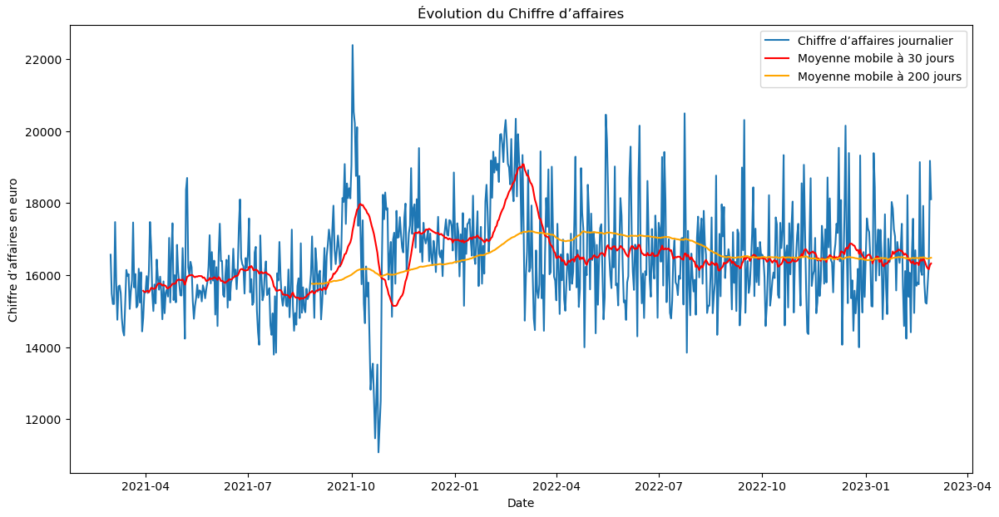

In [38]:
# Calculer les moyennes mobiles
mm_30 = df_CA_journalier.rolling(window=30).mean()
mm_200 = df_CA_journalier.rolling(window=180).mean()

# Tracer les moyennes mobiles
plt.figure(figsize=(14, 7))
plt.plot(df_CA_journalier, label='Chiffre d’affaires journalier')
plt.plot(mm_30, label='Moyenne mobile à 30 jours', color='red')
plt.plot(mm_200, label='Moyenne mobile à 200 jours', color='orange')
plt.title('Évolution du Chiffre d’affaires')
plt.xlabel('Date')
plt.ylabel('Chiffre d’affaires en euro')
plt.legend()
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">5.2 - Evolution du chiffre d'affaires mensuel et détails par categories</h3>
<a class="anchor" id="section_5_2"></a>
</div>

In [39]:
df_CA_journalier = df_Dateindex.groupby(df_Dateindex.index.date)['price'].sum()
df_CA_journalier

2021-03-01    16565.22
2021-03-02    15486.45
2021-03-03    15198.69
2021-03-04    15196.07
2021-03-05    17471.37
                ...   
2023-02-24    15207.89
2023-02-25    15761.25
2023-02-26    16304.72
2023-02-27    19170.81
2023-02-28    18105.15
Name: price, Length: 730, dtype: float64

In [40]:
df_Dateindex['Date'] = df_Dateindex.index.to_period('M')
df_Dateindex


,client_id,sex,age,id_prod,session_id,price,categ,Date
date,,,,,,,,
2021-03-13 21:35:55.949042,c_4410,Femme,57,1_483,s_5913,15.99,1,2021-03
2021-03-22 01:27:49.480137,c_4410,Femme,57,0_1111,s_9707,19.99,0,2021-03
2021-03-22 01:40:22.782925,c_4410,Femme,57,1_385,s_9707,25.99,1,2021-03
2021-03-22 14:29:25.189266,c_4410,Femme,57,0_1455,s_9942,8.99,0,2021-03
2021-03-22 22:31:25.825764,c_4410,Femme,57,0_1420,s_10092,11.53,0,2021-03
...,...,...,...,...,...,...,...,...
2022-05-14 00:24:49.391917,c_84,Femme,42,0_1472,s_208110,12.49,0,2022-05
2022-05-29 06:11:50.316631,c_84,Femme,42,0_1438,s_215697,9.31,0,2022-05
2022-12-17 00:16:56.629536,c_84,Femme,42,1_459,s_313173,15.99,1,2022-12


In [41]:
df_CA_mensuel = df_Dateindex.groupby('Date')['price'].sum()

In [42]:
# Calculer la moyenne mobile
mm_6_mensuel = round(df_CA_mensuel.rolling(window=6).mean(),2)

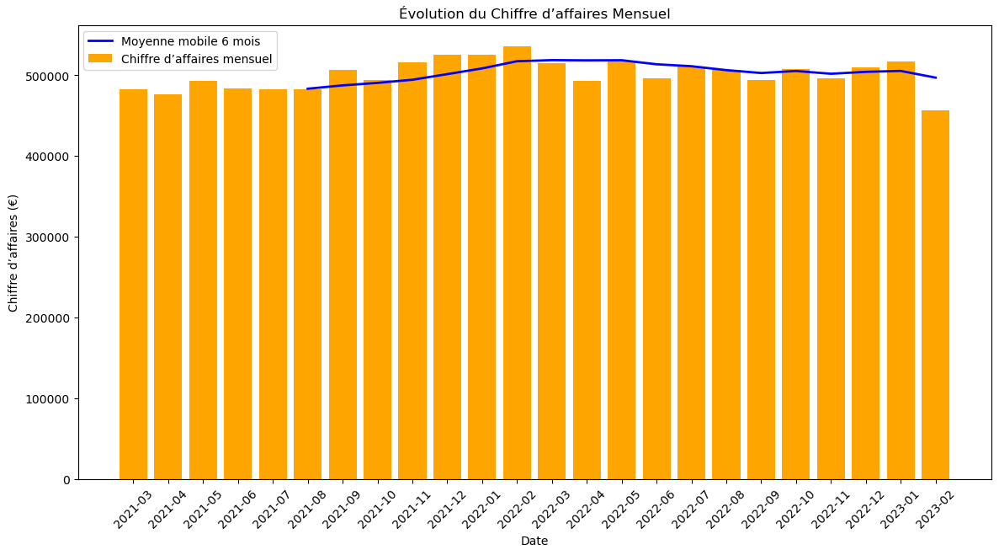

In [43]:
plt.figure(figsize=(14, 7))

df_CA_mensuel.index = df_CA_mensuel.index.astype(str)
mm_6_mensuel.index = mm_6_mensuel.index.astype(str)

# Création du barplot pour le chiffre d'affaires mensuel
plt.bar(df_CA_mensuel.index, df_CA_mensuel.values, label="Chiffre d’affaires mensuel", color='orange')

# Superposition de la moyenne mobile de 6 mois avec une ligne
plt.plot(mm_6_mensuel.index, mm_6_mensuel.values, label='Moyenne mobile 6 mois', color='blue', linewidth=2)

# Titres et de légendes
plt.title("Évolution du Chiffre d’affaires Mensuel")
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.ylabel("Chiffre d’affaires (€)")
plt.legend()

plt.show()


In [44]:
df_Dateindex

,client_id,sex,age,id_prod,session_id,price,categ,Date
date,,,,,,,,
2021-03-13 21:35:55.949042,c_4410,Femme,57,1_483,s_5913,15.99,1,2021-03
2021-03-22 01:27:49.480137,c_4410,Femme,57,0_1111,s_9707,19.99,0,2021-03
2021-03-22 01:40:22.782925,c_4410,Femme,57,1_385,s_9707,25.99,1,2021-03
2021-03-22 14:29:25.189266,c_4410,Femme,57,0_1455,s_9942,8.99,0,2021-03
2021-03-22 22:31:25.825764,c_4410,Femme,57,0_1420,s_10092,11.53,0,2021-03
...,...,...,...,...,...,...,...,...
2022-05-14 00:24:49.391917,c_84,Femme,42,0_1472,s_208110,12.49,0,2022-05
2022-05-29 06:11:50.316631,c_84,Femme,42,0_1438,s_215697,9.31,0,2022-05
2022-12-17 00:16:56.629536,c_84,Femme,42,1_459,s_313173,15.99,1,2022-12


In [45]:

# Grouper les données par période mensuelle et catégorie pour calculer la somme du chiffre d'affaires
df_grouper = df_Dateindex.groupby(['Date', 'categ'])['price'].sum().unstack(fill_value=0)

df_grouper.index.astype(str)

df_grouper

categ,0,1,2
Date,,,
2021-03,193629.17,186974.17,101837.27
2021-04,205222.46,156138.35,114748.49
2021-05,196186.72,165893.40,130863.35
2021-06,167943.15,189162.04,126983.37
2021-07,144750.79,188523.27,149561.34
2021-08,167737.62,162991.38,151555.79
2021-09,246353.91,190613.78,70272.99
2021-10,199250.83,207696.74,87785.59
2021-11,155909.56,252910.39,107347.78


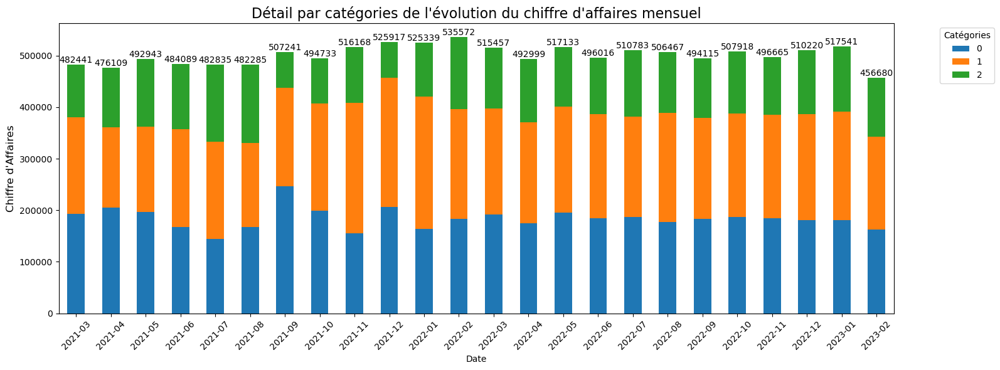

In [46]:
# Création du graphique
fig, ax = plt.subplots(figsize=(16, 6))

df_grouper.plot(kind='bar', stacked=True, ax=ax)

# Personnalisation du graphique
plt.title("Détail par catégories de l'évolution du chiffre d'affaires mensuel", fontsize=16)
plt.ylabel('Chiffre d\'Affaires', fontsize=12)
plt.legend(title='Catégories', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)

# Ajout des valeurs totales au-dessus de chaque barre
for i, total in enumerate(df_grouper.sum(axis=1)):
    ax.text(i, total, f'{total:.0f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">5.3 - Evolution du chiffre d'affaires cumulés</h3>
<a class="anchor" id="section_5_3"></a>
</div>

In [47]:
# Calculer le chiffre d'affaires cumulés
df_CA_cumulé = df_CA_journalier.cumsum()
df_CA_cumulé.head()

2021-03-01    16565.22
2021-03-02    32051.67
2021-03-03    47250.36
2021-03-04    62446.43
2021-03-05    79917.80
Name: price, dtype: float64

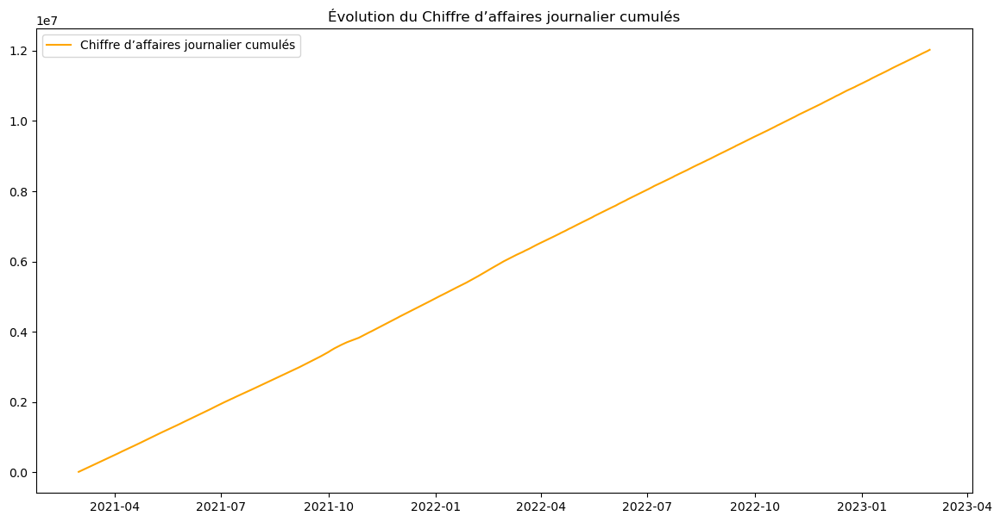

In [48]:
plt.figure(figsize=(14, 7))
df_CA_cumulé.plot(label='Chiffre d’affaires journalier cumulés', color='Orange')
plt.title('Évolution du Chiffre d’affaires journalier cumulés')
plt.legend()
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">5.4 - Total du chiffre d'affaires par catégories</h3>
<a class="anchor" id="section_5_4"></a>
</div>

In [49]:
df_CA_par_cat = df_lapage.groupby('categ')['price'].sum()
df_CA_par_cat


categ
0    4419730.97
1    4827657.11
2    2780275.02
Name: price, dtype: float64

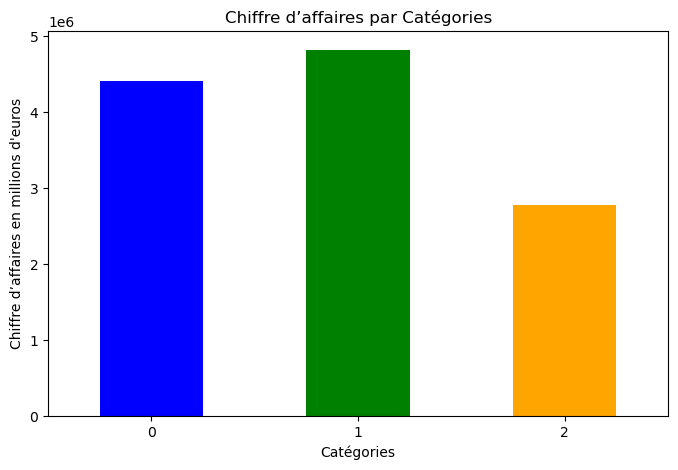

In [50]:
colors = ['blue', 'green', 'orange'] 

plt.figure(figsize=(8, 5))
df_CA_par_cat.plot(kind='bar', color=colors )
plt.title("Chiffre d’affaires par Catégories")
plt.xlabel('Catégories')
plt.ylabel("Chiffre d’affaires en millions d'euros")
plt.xticks(rotation=0)
plt.show()


<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 6 - Chiffres d'affaires par clients et definition des clients B2B
<a class="anchor" id="chapter6"></a>
</div>

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.1 - Distribution du CA par clients</h3>
<a class="anchor" id="section_6_1"></a>
</div>

In [51]:
# Calcul CA total par clients
df_CA_par_clients = df_lapage.groupby('client_id')['price'].sum().reset_index(name='CA_total')
# Trier le df par CA
df_CA_par_clients_tri = df_CA_par_clients.sort_values(by='CA_total')

In [52]:
# Merge sur 'client_id' pour ajouter la colonne au df_lapage
df_lapage = df_lapage.merge(df_CA_par_clients, on='client_id', how='left')

df_lapage

,client_id,sex,age,id_prod,date,session_id,price,categ,CA_total
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1,1376.82
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0,1376.82
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1,1376.82
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0,1376.82
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0,1376.82
...,...,...,...,...,...,...,...,...,...
687529,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0,427.51
687530,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0,427.51
687531,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1,427.51
687532,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0,427.51


In [53]:
# Création du graphique de distribution des transactions par client

fig = px.box(df_CA_par_clients_tri, y='CA_total', title='Distribution du CA par clients')
fig.show()

In [54]:
# Distribution du C.A par clients : Le graphique C.A par clients montre une distribution avec quelques valeurs très élevées, 

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.2 - Courbe de Lorenz et coeff de gini</h3>
<a class="anchor" id="section_6_2"></a>
</div>

In [55]:
pd.set_option('display.max_rows', 6801)
pd.set_option('display.max_columns', None)

print(df_CA_par_clients_tri)

     client_id   CA_total
8151    c_8351       6.31
7918    c_8140       8.30
7889    c_8114       9.98
4044    c_4648      11.20
3855    c_4478      13.36
...        ...        ...
634     c_1570    5285.82
2724    c_3454  114110.57
6337    c_6714  153918.60
4388    c_4958  290227.03
677     c_1609  326039.89

[8600 rows x 2 columns]


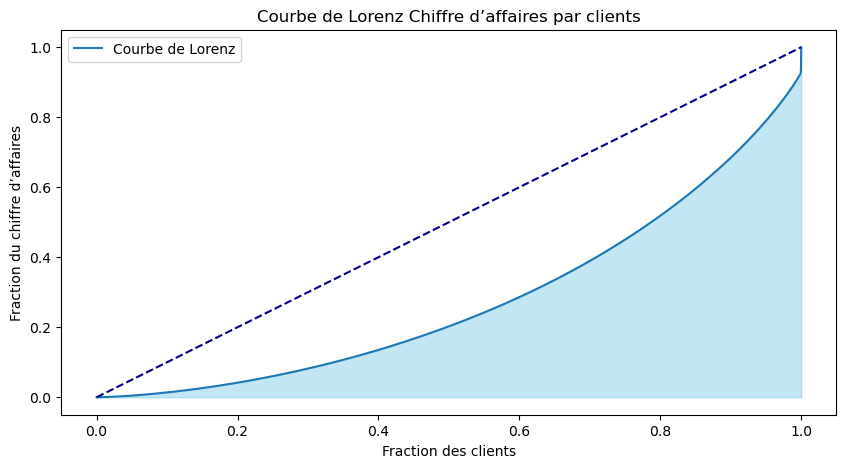

In [56]:
income = df_CA_par_clients_tri['CA_total'].values

# Tri des valeurs et calcul de la courbe de Lorenz
sorted_income = np.sort(income)
lorenz_curve = np.cumsum(sorted_income) / np.sum(sorted_income)
lorenz_curve = np.insert(lorenz_curve, 0, 0)  # Ajouter le point (0,0)


# Création de la courbe de Lorenz
plt.figure(figsize=(10, 5))
plt.plot(np.linspace(0.0, 1.0, lorenz_curve.size), lorenz_curve, label="Courbe de Lorenz")
plt.fill_between(np.linspace(0.0, 1.0, lorenz_curve.size), lorenz_curve, color='skyblue', alpha=0.5)
plt.title('Courbe de Lorenz Chiffre d’affaires par clients')
plt.xlabel('Fraction des clients')
plt.ylabel("Fraction du chiffre d’affaires")
plt.plot([0,1], [0,1], color='darkblue', linestyle='--')  # Ligne d'égalité parfaite
plt.legend()
plt.show()

In [57]:
def gini_coefficient(x):
    diffsum = 0
    for i, xi in enumerate(x[:-1], 1):
        diffsum += np.sum(np.abs(xi - x[i:]))
    return diffsum / (len(x)**2 * np.mean(x))

gini_brown = gini_coefficient(income)
print("Indice de Gini (méthode de Brown) :", round(gini_brown, 3))

Indice de Gini (méthode de Brown) : 0.442


In [58]:
#definir une function pour calculaler le coeff de Gini
def gini(x):
    total = 0
    for i, xi in enumerate(x[:-1], 1):
        total += np.sum(np.abs(xi - x[i:]))
    return total / (len(x)**2 * np.mean(x))

gini_lorenz = gini(income)

print("Indice de Gini :", round(gini_lorenz, 3))

Indice de Gini : 0.442


In [59]:
#L'indice de Gini calculé est de 0.884 :

# Cette valeur élevée de l'indice de Gini indique une inégalité dans la distribution du chiffre d'affaires parmi les clients : 
#  - une petite fraction des clients contribue à une grande part du chiffre d'affaires total. 

# Cela peut indiquer une dépendance vis à-vis de ces clients clés et souligner l'importance de stratégies de diversification et de fidélisation de la clientèle.

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.3 - Top 10 des clients par chiffre d'affaires total et détails pour chaques catégories</h3>
<a class="anchor" id="section_6_3"></a>
</div>

In [60]:
# Calcul du chiffre d'affaires par clients pour chaques catégories
df_CA_par_categ_clients = df_lapage.groupby(['client_id', 'categ'])['price'].sum().reset_index(name='CA_par_categ')

df_CA_par_categ_clients


,client_id,categ,CA_par_categ
0,c_1,0,360.15
1,c_1,1,214.00
2,c_1,2,54.87
3,c_10,0,263.87
4,c_10,1,809.77
...,...,...,...
19947,c_998,0,176.34
19948,c_998,1,242.47
19949,c_998,2,2403.41
19950,c_999,0,153.19


In [61]:
# Fonction pivot pour transformer les catégories en colonnes séparées 
df_CA_categ_pivot = df_CA_par_categ_clients.pivot(index='client_id', columns='categ', values='CA_par_categ').fillna(0)

# Cmpréhension de liste pour renommer les colonne
df_CA_categ_pivot.columns = [f'C.A_catégories {c}' for c in df_CA_categ_pivot.columns]

df_CA_categ_pivot

,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2
client_id,,,
c_1,360.15,214.00,54.87
c_10,263.87,809.77,279.96
c_100,31.38,84.94,138.53
c_1000,386.85,1905.03,0.00
c_1001,907.73,616.12,300.00
...,...,...,...
c_995,125.67,63.74,0.00
c_996,485.77,1151.57,0.00
c_997,207.28,471.75,810.98


In [62]:
# Merge sur 'client_id' pour ajouter les colonnes au df_lapage
df_lapage = df_lapage.merge(df_CA_categ_pivot, on='client_id', how='left').fillna(0)

df_lapage

,client_id,sex,age,id_prod,date,session_id,price,categ,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1,1376.82,501.56,729.27,145.99
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0,1376.82,501.56,729.27,145.99
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1,1376.82,501.56,729.27,145.99
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0,1376.82,501.56,729.27,145.99
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0,1376.82,501.56,729.27,145.99
...,...,...,...,...,...,...,...,...,...,...,...,...
687529,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0,427.51,254.09,173.42,0.00
687530,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0,427.51,254.09,173.42,0.00
687531,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1,427.51,254.09,173.42,0.00
687532,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0,427.51,254.09,173.42,0.00


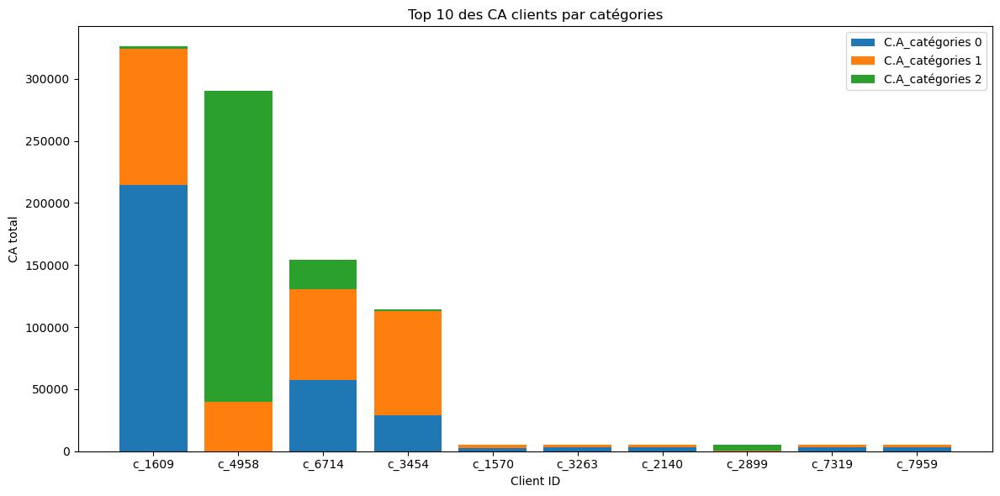

In [63]:
# Recalculer le ca total pour le df df_CA_categ_pivot
df_CA_categ_pivot['CA_total'] = df_CA_categ_pivot.sum(axis=1)
df_CA_categ_pivot_tri = df_CA_categ_pivot.sort_values('CA_total', ascending=False)

# Sélectionner les 10 premiers clients
top_10 = df_CA_categ_pivot_tri.head(10)

# Créer le graphique
fig, ax = plt.subplots(figsize=(12, 6))

bottom = np.zeros(10)
for category in ['C.A_catégories 0', 'C.A_catégories 1', 'C.A_catégories 2']:
    ax.bar(top_10.index, top_10[category], bottom=bottom, label=category)
    bottom += top_10[category]

ax.set_title("Top 10 des CA clients par catégories")
ax.set_xlabel("Client ID")
ax.set_ylabel("CA total")
ax.legend()
plt.tight_layout()
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.4 - Definition des clients Outlier par le CA (methode IQR)</h3>
<a class="anchor" id="section_6_4"></a>
</div>

In [64]:
#outlier du graphique 6.1 par le calcul (IQR)

# Définir les seuils pour les outliers graphique 6.1
Q3, Q1 = np.percentile(df_CA_par_clients_tri['CA_total'], [75, 25])
iqr = Q3 - Q1 
seuil_bas = Q1 - 1.5 * iqr
seuil_haut = Q3 + 1.5 * iqr

# Identifier les outliers
outliers = df_CA_par_clients_tri[df_CA_par_clients_tri['CA_total'] > seuil_haut]

# Analyser les outliers
nombre_outliers = outliers.shape[0]
proportion_outliers = round(nombre_outliers / df_CA_par_clients_tri['CA_total'].shape[0],2)

print(seuil_bas,seuil_haut)
print(f"Nombre d'outliers: {nombre_outliers}")
print(f"Proportion d'outliers: {proportion_outliers}")

-1289.7549999999997 3650.2049999999995
Nombre d'outliers: 251
Proportion d'outliers: 0.03


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.5 - Definition des clients Outlier par le CA (methode Zscore) </h3>
<a class="anchor" id="section_6_5"></a>
</div>

In [65]:
# Calcul de la moyenne et de l'écart-type du nombre de transactions
moyenne_transactions = df_CA_par_clients_tri['CA_total'].mean()
ecart_type_transactions = df_CA_par_clients_tri['CA_total'].std()

# Calcul du Z-score 
# Z-score = (valeur - moyenne) / écart-type
df_CA_par_clients_tri['z_score'] = (df_CA_par_clients_tri['CA_total'] - moyenne_transactions) / ecart_type_transactions

# Filtrer pour obtenir les client_id avec des les nombres de transactions ou le Z-score est supérieur à 3
transactions_zscore_sup3 = df_CA_par_clients_tri[df_CA_par_clients_tri['z_score'] > 3][['client_id', 'CA_total', 'z_score']]

print(transactions_zscore_sup3)

     client_id   CA_total    z_score
2724    c_3454  114110.57  21.663838
6337    c_6714  153918.60  29.315150
4388    c_4958  290227.03  55.514345
677     c_1609  326039.89  62.397765


In [66]:
# Création de la variable Clients_B2B avec les client_id ou pour le nombre de transactions est supperieur a 3 z_score
Clients_B2B = transactions_zscore_sup3['client_id']
Clients_B2B

2724    c_3454
6337    c_6714
4388    c_4958
677     c_1609
Name: client_id, dtype: object

Comparativement à la methode IQR (idem sur le graphique distribution CA par clients), le Z-score être plus approprié car il se concentre sur des écarts plus significatifs afin de cibler les 4 clients B2B 

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.6 - Exclusion des 4 clients B2B</h3>
<a class="anchor" id="section_6_6"></a>
</div>

In [67]:
df_CA_par_clients

,client_id,CA_total
0,c_1,629.02
1,c_10,1353.60
2,c_100,254.85
3,c_1000,2291.88
4,c_1001,1823.85
...,...,...
8595,c_995,189.41
8596,c_996,1637.34
8597,c_997,1490.01
8598,c_998,2822.22


In [68]:
# Conserve uniquement les clients B2B du df_CA_par_clients
df_lapage_b2b = df_lapage[df_lapage['client_id'].isin(Clients_B2B)].copy()

# exclut les clients B2B du df_lapage
df_lapage = df_lapage[~df_lapage['client_id'].isin(Clients_B2B)].copy()

# Conserve uniquement les clients B2B du df_CA_par_clients
df_CA_par_clients_B2B = df_CA_par_clients[df_CA_par_clients['client_id'].isin(Clients_B2B)].copy()

# exclut les clients B2B du df_CA_par_clients
df_CA_par_clients = df_CA_par_clients[~df_CA_par_clients['client_id'].isin(Clients_B2B)].copy()

df_CA_par_clients_B2B

,client_id,CA_total
677,c_1609,326039.89
2724,c_3454,114110.57
4388,c_4958,290227.03
6337,c_6714,153918.60


In [69]:
df_CA_par_clients

,client_id,CA_total
0,c_1,629.02
1,c_10,1353.60
2,c_100,254.85
3,c_1000,2291.88
4,c_1001,1823.85
...,...,...
8595,c_995,189.41
8596,c_996,1637.34
8597,c_997,1490.01
8598,c_998,2822.22


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.7 - Répartition du chiffre d'affaires entre clients et B2B et détails des catégories pour les B2B, </h3>
<a class="anchor" id="section_6_7"></a>
</div>

In [70]:
df_CA_comp = pd.DataFrame({
    'Clients B2B': [df_CA_par_clients_B2B['CA_total'].sum()],
    'Clients particuliers': [df_CA_par_clients['CA_total'].sum()]
})

print(df_CA_comp)

   Clients B2B  Clients particuliers
0    884296.09           11143367.01


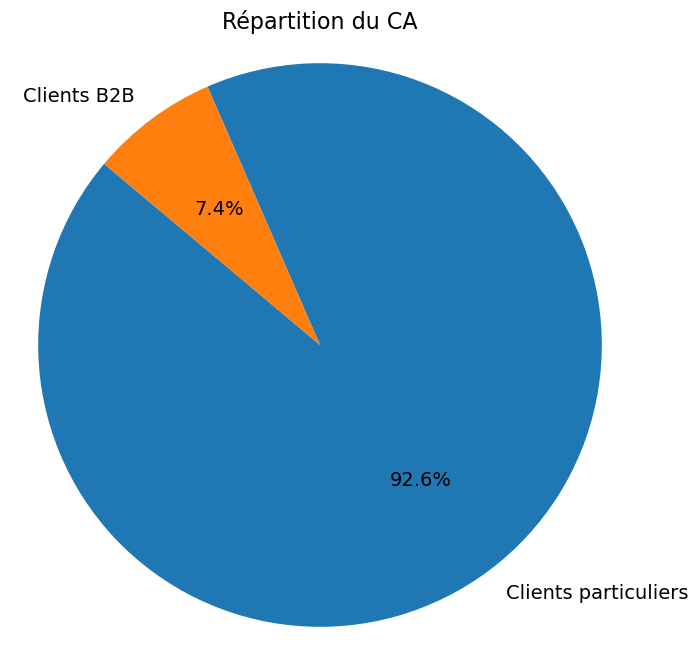

In [71]:
# Préparation des données pour le graphique
labels = ['Clients particuliers', 'Clients B2B']
values = [df_CA_comp['Clients particuliers'][0], df_CA_comp['Clients B2B'][0]]

# Création du pie chart
plt.figure(figsize=(8, 8))
wedges, texts, autotexts = plt.pie(values, labels=labels, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 14})

plt.title('Répartition du CA', fontsize = 16)
plt.axis('equal')  # Assure que le pie chart soit circulaire

# Affichage du graphique
plt.show()

In [72]:
# Conserve uniquement les clients B2B dans le df_categ_pivot pour le graphique
df_CA_categ_pivot_B2B = df_CA_categ_pivot[df_CA_categ_pivot.index.isin(Clients_B2B)]
df_CA_categ_pivot_B2B_tri = df_CA_categ_pivot_B2B.sort_values('CA_total', ascending=False)
df_CA_categ_pivot_B2B_tri



,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,CA_total
client_id,,,,
c_1609,214447.24,110091.44,1501.21,326039.89
c_4958,48.76,39841.93,250336.34,290227.03
c_6714,57254.59,73566.22,23097.79,153918.60
c_3454,28779.69,84055.66,1275.22,114110.57


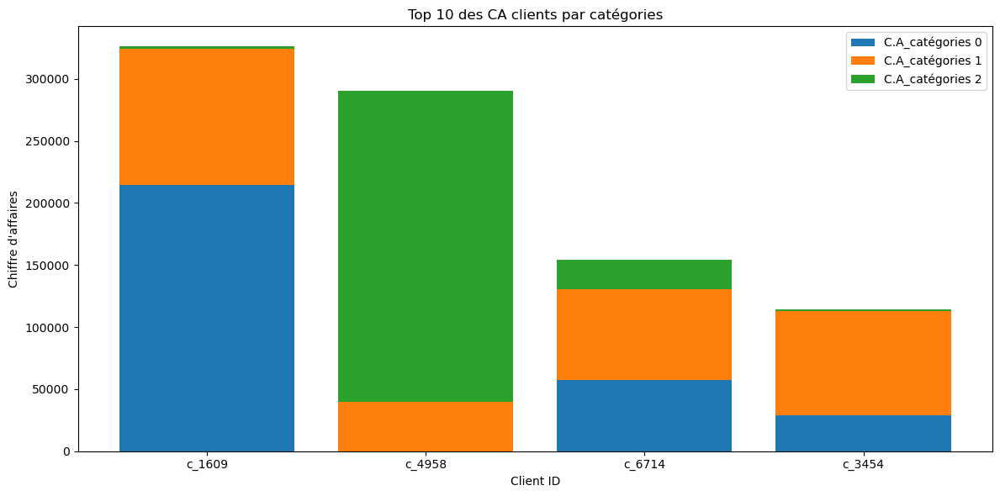

In [73]:
# Créer le graphique
fig, ax = plt.subplots(figsize=(12, 6))

bottom = np.zeros(4)
for category in ['C.A_catégories 0', 'C.A_catégories 1', 'C.A_catégories 2']:
    ax.bar(df_CA_categ_pivot_B2B_tri.index, df_CA_categ_pivot_B2B_tri[category], bottom=bottom, label=category)
    bottom += df_CA_categ_pivot_B2B_tri[category]

ax.set_title("Top 10 des CA clients par catégories")
ax.set_xlabel("Client ID")
ax.set_ylabel("Chiffre d'affaires")
ax.legend()
plt.tight_layout()
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.8 - Top 10 des clients par chiffre d'affaires total et détails pour chaques catégories (clients B2B exclus)</h3>
<a class="anchor" id="section_6_8"></a>
</div>

In [74]:
# Exclue les B2B dans le df_categ_pivot pour le graphique
df_CA_categ_pivot = df_CA_categ_pivot[~df_CA_categ_pivot.index.isin(Clients_B2B)]
df_CA_categ_pivot_tri = df_CA_categ_pivot.sort_values('CA_total', ascending=False)
df_CA_categ_pivot_tri



,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,CA_total
client_id,,,,
c_1570,2812.80,2327.03,145.99,5285.82
c_3263,3399.29,1877.58,0.00,5276.87
c_2140,3360.28,1753.91,145.99,5260.18
c_2899,25.38,779.01,4409.66,5214.05
c_7319,2936.17,2175.61,43.99,5155.77
...,...,...,...,...
c_4478,13.36,0.00,0.00,13.36
c_4648,0.00,11.20,0.00,11.20
c_8114,9.98,0.00,0.00,9.98


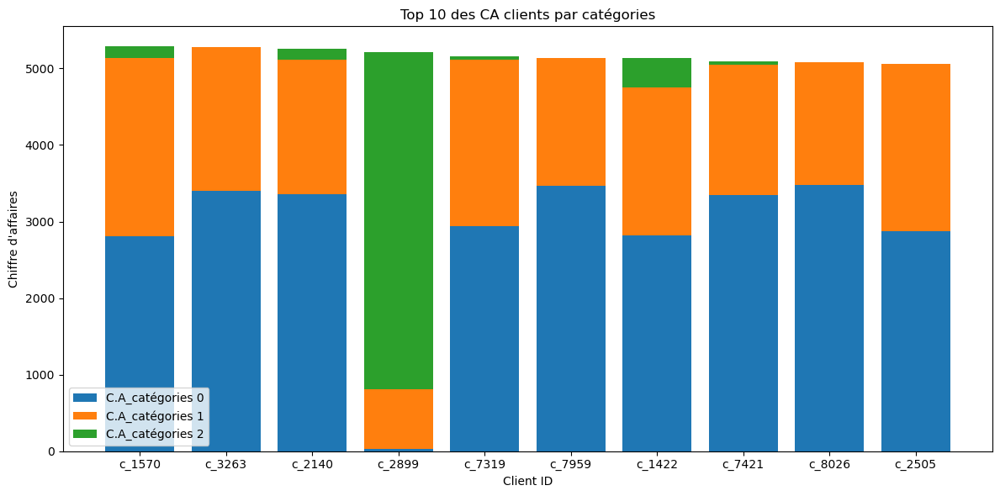

In [75]:
# Sélectionner les 10 premiers clients
top_10 = df_CA_categ_pivot_tri.head(10)

# Créer le graphique
fig, ax = plt.subplots(figsize=(12, 6))

bottom = np.zeros(10)
for category in ['C.A_catégories 0', 'C.A_catégories 1', 'C.A_catégories 2']:
    ax.bar(top_10.index, top_10[category], bottom=bottom, label=category)
    bottom += top_10[category]

ax.set_title("Top 10 des CA clients par catégories")
ax.set_xlabel("Client ID")
ax.set_ylabel("Chiffre d'affaires")
ax.legend()
plt.tight_layout()
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">6.9 - 80/20 en Chiffre d'Affaires (Analyse de Pareto) </h3>
<a class="anchor" id="section_6_9"></a>
</div>

In [76]:
# Calcul du chiffre d'affaires par produits
df_CA_par_Prods = df_lapage.groupby('id_prod')['price'].sum().sort_values(ascending=False).reset_index(name='CA_par_produits')

# Calcul du cumul de CA
ca_par_Prods_cumsum = df_CA_par_Prods['CA_par_produits'].cumsum()

# Calcul du CA total et détermination du seuil 80/20
total_CA_Prods = ca_par_Prods_cumsum.iloc[-1]
pareto_threshold2 = total_CA_Prods * 0.8

# Détermination des produits qui composent les 80% du CA
top_80_Prods = df_CA_par_Prods[ca_par_Prods_cumsum <= pareto_threshold2]

# Calcul du pourcentage des produits dans le top 80%
percent_80_Prods = len(top_80_Prods) / len(df_CA_par_Prods) * 100

# Détermination des produits qui composent les 20% restants du CA
top_20_Prods = df_CA_par_Prods[ca_par_Prods_cumsum > pareto_threshold2]

# Calcul du pourcentage des produits dans le top 20%
percent_20_Prods = len(top_20_Prods) / len(df_CA_par_Prods) * 100

# Ajout d'une impression pour visualiser les résultats
print(f"Pourcentage des produits qui représentent 80% du CA: {percent_80_Prods:.2f}%")
print(f"Pourcentage des produits qui représentent 20% du CA: {percent_20_Prods:.2f}%")


Pourcentage des produits qui représentent 80% du CA: 21.49%
Pourcentage des produits qui représentent 20% du CA: 78.51%


In [77]:
# Extraction des id_prod qui représentent 80% du CA
liste_produits_80CA = top_80_Prods['id_prod'].tolist()

# Impression des id_prod
print(f"Les id_prod qui représentent 80% du CA sont : {liste_produits_80CA}")

df_produits_CA80 = df_produits[df_produits['id_prod'].isin(liste_produits_80CA)]

# Compter le nombre de références pour chaques catégories
df_produits_CA80 = df_produits_CA80.groupby('categ')['id_prod'].count()
df_produits_CA80

Les id_prod qui représentent 80% du CA sont : ['2_159', '2_135', '2_112', '2_102', '1_369', '1_395', '2_209', '1_414', '1_383', '2_166', '2_110', '1_498', '2_39', '1_406', '1_366', '2_43', '1_385', '1_431', '1_378', '1_379', '1_417', '1_389', '2_202', '1_456', '2_208', '2_167', '2_37', '2_101', '2_207', '2_108', '2_109', '1_432', '1_396', '1_413', '2_163', '1_425', '1_403', '2_32', '1_286', '1_397', '2_191', '2_158', '1_457', '1_437', '1_392', '1_412', '2_160', '1_426', '1_376', '1_407', '1_279', '1_475', '2_156', '1_480', '1_400', '1_441', '1_388', '2_62', '1_442', '1_445', '1_381', '1_468', '1_267', '1_446', '2_96', '2_155', '1_265', '1_262', '2_104', '2_181', '2_46', '1_451', '1_256', '1_277', '1_281', '1_287', '1_343', '1_351', '2_164', '1_282', '2_41', '2_184', '1_274', '2_147', '1_353', '2_113', '1_462', '1_433', '0_1421', '0_1441', '1_483', '1_325', '2_175', '1_459', '1_367', '2_150', '1_464', '1_365', '2_169', '1_466', '2_172', '1_305', '2_162', '2_211', '1_313', '2_230', '2_79

categ
0    319
1    262
2    120
Name: id_prod, dtype: int64

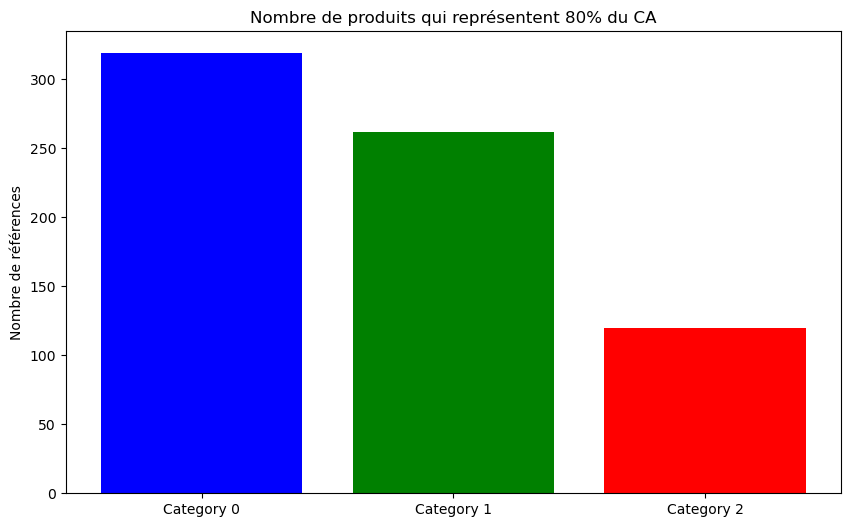

In [78]:
# Couleurs pour les catégories
colors = ['blue', 'green', 'red']


plt.figure(figsize=(10, 6))
plt.bar(['Category 0', 'Category 1', 'Category 2'], 
        [df_produits_CA80.iloc[0], df_produits_CA80.iloc[1], df_produits_CA80.iloc[2]], 
        color=colors)

plt.title("Nombre de produits qui représentent 80% du CA")
plt.ylabel('Nombre de références')

plt.show()


In [79]:
# Calcul du cumul de CA
ca_par_clients_cumsum = df_CA_par_clients['CA_total'].cumsum()

# Calcul du CA total et détermination du seuil 80/20
total_CA = ca_par_clients_cumsum.iloc[-1]
pareto_threshold = total_CA * 0.8

# Détermination des clients qui composent les 80% du CA
top_80_clients = df_CA_par_clients[ca_par_clients_cumsum <= pareto_threshold]

# Calcul du pourcentage des clients dans le top 80%
percent_80_clients = len(top_80_clients) / len(df_CA_par_clients) * 100

# Détermination des clients qui composent les 20% restants du CA
top_20_clients = df_CA_par_clients[ca_par_clients_cumsum > pareto_threshold]

# Calcul du pourcentage des clients dans le top 20%
percent_20_clients = len(top_20_clients) / len(df_CA_par_clients) * 100

# Ajout d'une impression pour visualiser les résultats
print(f"Pourcentage des clients qui génèrent 80% du CA: {percent_80_clients:.2f}%")
print(f"Pourcentage des clients qui génèrent 20% du CA: {percent_20_clients:.2f}%")


Pourcentage des clients qui génèrent 80% du CA: 79.99%
Pourcentage des clients qui génèrent 20% du CA: 20.01%


<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 7 - Indicateurs des ventes (KPI's)
<a class="anchor" id="chapter7"></a>
</div>

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.1 - Nombre de transactions par clients et par categories</h3>
<a class="anchor" id="section_7_1"></a>
</div>

In [80]:
# Group by client_id puis count transactions
df_transactions_groupés = df_lapage.groupby('client_id').size().reset_index(name='Nombre de transactions')

df_transactions_groupés

,client_id,Nombre de transactions
0,c_1,43
1,c_10,58
2,c_100,8
3,c_1000,126
4,c_1001,103
...,...,...
8591,c_995,14
8592,c_996,96
8593,c_997,59
8594,c_998,55


In [81]:
# création du graphique nombre de transactions par client

fig = px.box(df_transactions_groupés, y='Nombre de transactions', title='Nombre de transactions par client')

fig.show()

In [82]:
# Jointure avec df_lapage pour ajouter la colonne Nombre de transactions
df_lapage = df_lapage.merge(df_transactions_groupés, on='client_id', how='left')
df_lapage

,client_id,sex,age,id_prod,date,session_id,price,categ,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,Nombre de transactions
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1,1376.82,501.56,729.27,145.99,76
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0,1376.82,501.56,729.27,145.99,76
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1,1376.82,501.56,729.27,145.99,76
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0,1376.82,501.56,729.27,145.99,76
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0,1376.82,501.56,729.27,145.99,76
...,...,...,...,...,...,...,...,...,...,...,...,...,...
640729,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0,427.51,254.09,173.42,0.00,28
640730,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0,427.51,254.09,173.42,0.00,28
640731,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1,427.51,254.09,173.42,0.00,28
640732,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0,427.51,254.09,173.42,0.00,28


In [83]:
# Calcul du nb_transactions par catégories pour chaques clients
df_Transactions_par_categ_client = df_lapage.groupby(['client_id', 'categ'])['Nombre de transactions'].size().reset_index(name='Nb_transactions_par_categ')

df_Transactions_par_categ_client.head()

,client_id,categ,Nb_transactions_par_categ
0,c_1,0,30
1,c_1,1,12
2,c_1,2,1
3,c_10,0,20
4,c_10,1,34


In [84]:
# Création d'un boxplot nombre de transactions par clients et par catégories
fig = px.box(df_lapage, x='categ', y='Nombre de transactions', color='categ',
             title='Nombre de transactions par clients et par catégories')
fig.update_layout(xaxis_title='Catégories', yaxis_title='Prix', boxgap=0.4)

fig.show()

In [85]:
# Fonction pivot pour transformer les catégories en colonnes séparées 
df_transactions_categ_pivot = df_Transactions_par_categ_client.pivot(index='client_id', columns='categ', values='Nb_transactions_par_categ').fillna(0)

# Cmpréhension de liste pour renommer les colonne
df_transactions_categ_pivot.columns = [f'Nombre de transactions catégorie {c}' for c in df_transactions_categ_pivot.columns]

# Merge les deux DataFrames sur 'client_id'
df_lapage = df_lapage.merge(df_transactions_categ_pivot, on='client_id', how='left').fillna(0)
df_lapage

,client_id,sex,age,id_prod,date,session_id,price,categ,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,Nombre de transactions,Nombre de transactions catégorie 0,Nombre de transactions catégorie 1,Nombre de transactions catégorie 2
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
640729,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0
640730,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0
640731,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0
640732,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.2 - Evolution du nombre de transactions (mensuel) </h3>
<a class="anchor" id="section_7_2"></a>
</div>

In [86]:
#Nombre de transactions total :

NbDeTransactionsTotal = len(df_lapage)

print("Nombre transactions total : ", NbDeTransactionsTotal)

Nombre transactions total :  640734


In [87]:
# Extraire l'année et le mois puis grouper par cette nouvelle colonne
df_lapage['Date'] = df_lapage['date'].dt.to_period('M')
df_transactions_mensuel = df_lapage.groupby('Date').size()

print(df_transactions_mensuel)

Date
2021-03    26647
2021-04    26470
2021-05    26272
2021-06    25038
2021-07    23075
2021-08    23955
2021-09    30975
2021-10    28313
2021-11    26319
2021-12    30208
2022-01    27416
2022-02    27569
2022-03    27703
2022-04    25659
2022-05    27946
2022-06    26479
2022-07    26715
2022-08    26622
2022-09    26387
2022-10    27014
2022-11    26641
2022-12    26519
2023-01    27019
2023-02    23773
Freq: M, dtype: int64


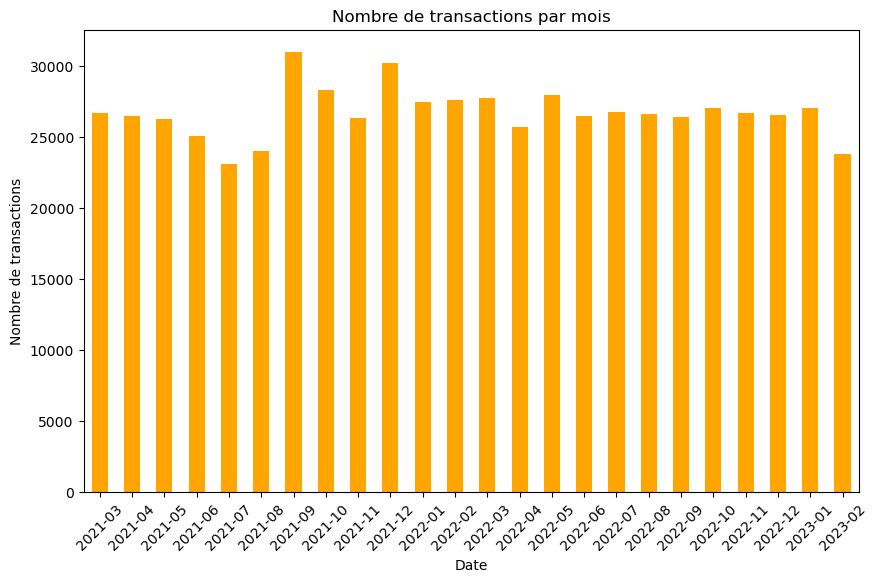

In [88]:
plt.figure(figsize=(10, 6))
df_transactions_mensuel.plot(kind='bar', color='orange')
plt.title('Nombre de transactions par mois')
plt.ylabel('Nombre de transactions')
plt.xticks(rotation=45)
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.3 - Nombre de sessions par clients
<a class="anchor" id="section_7_3"></a>
</div>

In [89]:
# Calcul du nombre de sessions uniques par client
df_Nb_de_sessions = df_lapage.groupby('client_id')['session_id'].nunique().reset_index(name='Nb_Session')

# Fusion avec le DataFrame principal
df_lapage = df_lapage.merge(df_Nb_de_sessions, on='client_id', how='left')

df_lapage


,client_id,sex,age,id_prod,date,session_id,price,categ,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,Nombre de transactions,Nombre de transactions catégorie 0,Nombre de transactions catégorie 1,Nombre de transactions catégorie 2,Date,Nb_Session
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
640729,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-05,14
640730,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-05,14
640731,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-12,14
640732,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-12,14


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.4 - Panier moyen par clients
<a class="anchor" id="section_7_4"></a>
</div>

In [90]:
# Calcul du panier moyen par client
df_lapage['Panier_Moyen'] = round((df_lapage['CA_total'] / df_lapage['Nb_Session']),2)

df_lapage

,client_id,sex,age,id_prod,date,session_id,price,categ,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,Nombre de transactions,Nombre de transactions catégorie 0,Nombre de transactions catégorie 1,Nombre de transactions catégorie 2,Date,Nb_Session,Panier_Moyen
0,c_4410,Femme,57,1_483,2021-03-13 21:35:55.949042,s_5913,15.99,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52,26.48
1,c_4410,Femme,57,0_1111,2021-03-22 01:27:49.480137,s_9707,19.99,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52,26.48
2,c_4410,Femme,57,1_385,2021-03-22 01:40:22.782925,s_9707,25.99,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52,26.48
3,c_4410,Femme,57,0_1455,2021-03-22 14:29:25.189266,s_9942,8.99,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52,26.48
4,c_4410,Femme,57,0_1420,2021-03-22 22:31:25.825764,s_10092,11.53,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,2021-03,52,26.48
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
640729,c_84,Femme,42,0_1472,2022-05-14 00:24:49.391917,s_208110,12.49,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-05,14,30.54
640730,c_84,Femme,42,0_1438,2022-05-29 06:11:50.316631,s_215697,9.31,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-05,14,30.54
640731,c_84,Femme,42,1_459,2022-12-17 00:16:56.629536,s_313173,15.99,1,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-12,14,30.54
640732,c_84,Femme,42,0_1104,2022-12-17 00:24:14.357525,s_313173,13.21,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,2022-12,14,30.54


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.5 - Evolution du nombre de clients (mensuel) </h3>
<a class="anchor" id="section_7_5"></a>
</div>

In [91]:
df_Dateindex['Date'] = df_Dateindex.index.to_period('M')
df_clients_par_mois = df_Dateindex.groupby('Date')['client_id'].nunique()
df_clients_par_mois

Date
2021-03    5676
2021-04    5674
2021-05    5644
2021-06    5659
2021-07    5672
2021-08    5642
2021-09    5693
2021-10    6190
2021-11    5875
2021-12    5867
2022-01    5809
2022-02    5729
2022-03    5835
2022-04    5695
2022-05    5843
2022-06    5717
2022-07    5778
2022-08    5805
2022-09    5738
2022-10    5755
2022-11    5749
2022-12    5765
2023-01    5828
2023-02    5587
Freq: M, Name: client_id, dtype: int64

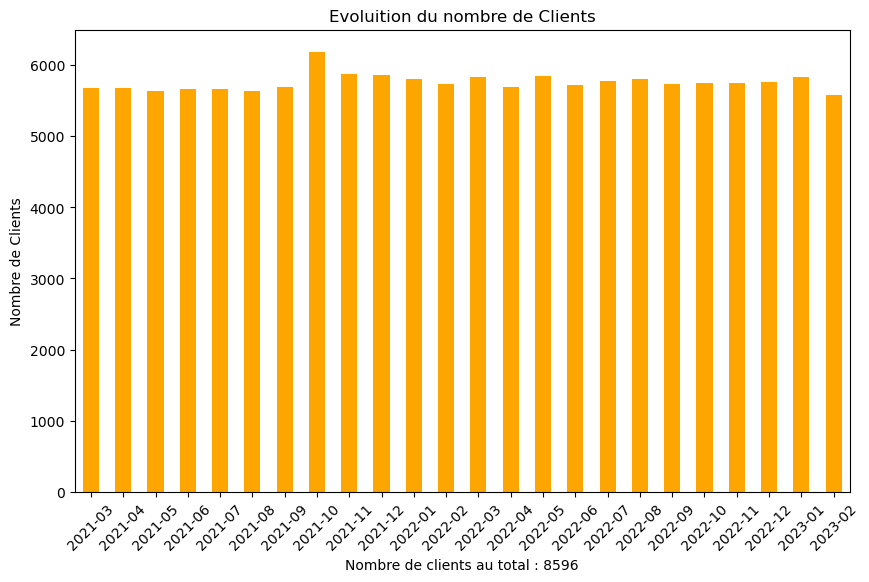

In [92]:
plt.figure(figsize=(10, 6))
df_clients_par_mois.plot(kind='bar', color='orange')
plt.title('Evoluition du nombre de Clients')
plt.xlabel('Nombre de clients au total : 8596')
plt.ylabel('Nombre de Clients')
plt.xticks(rotation=45)
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.6 - Nombre de références vendus par mois</h3>
<a class="anchor" id="section_7_6"></a>
</div>

In [93]:
#Nombre de références au total :

NbDeReferencesTotal = df_lapage['id_prod'].nunique()

print("Nombre de références au total :", NbDeReferencesTotal)

Nombre de références au total : 3262


In [94]:
df_Dateindex['Date'] = df_Dateindex.index.to_period('M')
df_nb_de_references = df_Dateindex.groupby('Date')['id_prod'].nunique()
df_nb_de_references

Date
2021-03    2482
2021-04    2492
2021-05    2471
2021-06    2414
2021-07    2369
2021-08    2404
2021-09    2560
2021-10    2506
2021-11    2432
2021-12    2505
2022-01    2470
2022-02    2477
2022-03    2474
2022-04    2462
2022-05    2485
2022-06    2451
2022-07    2470
2022-08    2463
2022-09    2452
2022-10    2489
2022-11    2448
2022-12    2438
2023-01    2488
2023-02    2407
Freq: M, Name: id_prod, dtype: int64

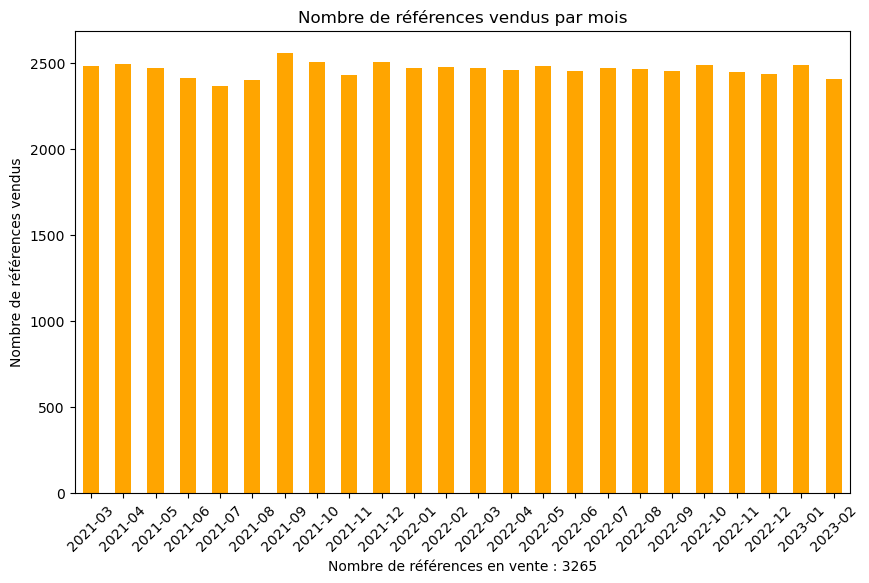

In [95]:
plt.figure(figsize=(10, 6))
df_nb_de_references.plot(kind='bar', color='orange')
plt.title('Nombre de références vendus par mois')
plt.xlabel('Nombre de références en vente : 3265')
plt.ylabel('Nombre de références vendus')
plt.xticks(rotation=45)
plt.show()

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">7.7 - Tops et Flops Références Vendues par An  </h3>
<a class="anchor" id="section_7_7"></a>
</div>

In [96]:
# Extraction de l'année
df_lapage['Année'] = df_lapage['date'].dt.year

# Groupe par année, categorie et id_prod, compter les transactions
vente_an = df_lapage.groupby(['Année', 'categ', 'id_prod']).size().reset_index(name='Ventes')

# Top références vendues par année et categorie
top_refs_annee = vente_an.sort_values(by=['Année', 'categ', 'Ventes'],ascending=[True, True, False]).groupby(['Année', 'categ']).head(10).reset_index(drop=True)

# Flop références vendues par année et categorie
flop_refs_annee = vente_an.sort_values(by=['Année', 'categ', 'Ventes'],ascending=[True, True, True]).groupby(['Année', 'categ']).head(10).reset_index(drop=True)

# Définir Année, categ, et id_prod comme index pour éviter la répétition et␣pour un affichage propre
top_refs_annee.set_index(['Année', 'categ', 'id_prod'], inplace=True)
flop_refs_annee.set_index(['Année', 'categ', 'id_prod'], inplace=True)


print(top_refs_annee)
print(flop_refs_annee)


                     Ventes
Année categ id_prod        
2021  0     0_1422      544
            0_1437      497
            0_1434      495
            0_1431      494
            0_1425      493
            0_1428      493
            0_1430      492
            0_1416      491
            0_0         488
            0_1409      487
      1     1_369       877
            1_417       854
            1_414       835
            1_498       809
            1_413       801
            1_425       791
            1_396       769
            1_407       769
            1_412       765
            1_398       764
      2     2_135       365
            2_102       357
            2_112       344
            2_110       328
            2_39        317
            2_37        315
            2_207       297
            2_209       289
            2_208       288
            2_46        266
2022  0     0_1425      622
            0_1431      616
            0_1432      614
            0_1441  

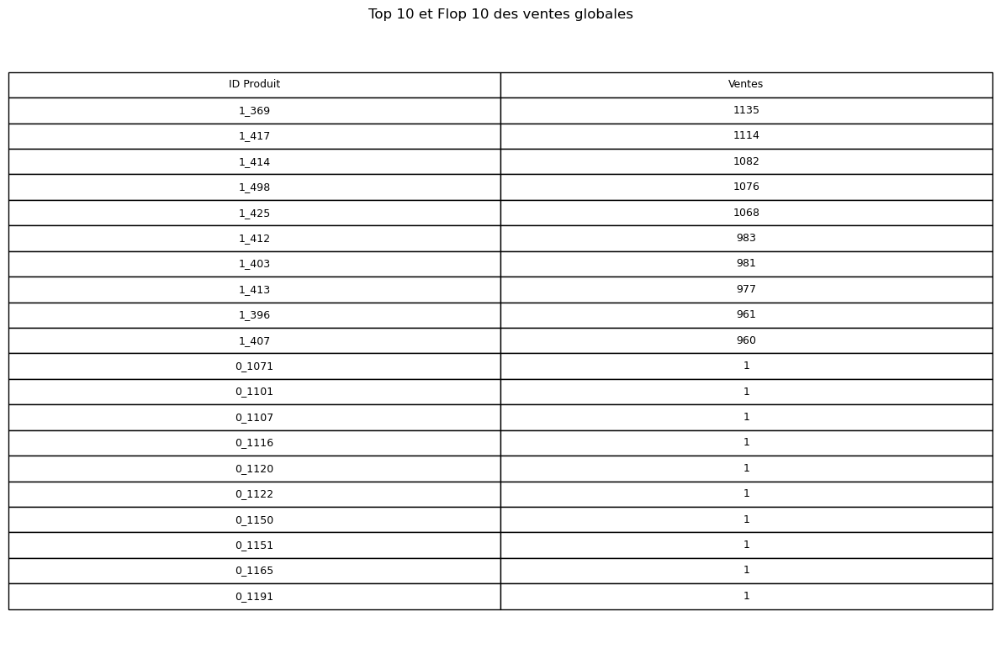

Top 10 global:
id_prod  Ventes
  1_369    1135
  1_417    1114
  1_414    1082
  1_498    1076
  1_425    1068
  1_412     983
  1_403     981
  1_413     977
  1_396     961
  1_407     960

Flop 10 global:
id_prod  Ventes
 0_1071       1
 0_1101       1
 0_1107       1
 0_1116       1
 0_1120       1
 0_1122       1
 0_1150       1
 0_1151       1
 0_1165       1
 0_1191       1


In [97]:
# Calcul du top 10 global
top_10_global = vente_an.nlargest(10, 'Ventes')[['id_prod', 'Ventes']]

# Calcul du flop 10 global
flop_10_global = vente_an.nsmallest(10, 'Ventes')[['id_prod', 'Ventes']]

# Création de la figure et des axes
fig, ax = plt.subplots(figsize=(12, 8))
ax.axis('tight')
ax.axis('off')

# Préparation des données pour le tableau
table_data = pd.concat([top_10_global, flop_10_global])
table_data = table_data.reset_index(drop=True)  # Supprime l'index

# Création du tableau
table = ax.table(cellText=table_data.values,
                 colLabels=['ID Produit', 'Ventes'],
                 cellLoc='center',
                 loc='center')

# Ajustement de la taille de la police
table.auto_set_font_size(False)
table.set_fontsize(9)
table.scale(1, 1.5)  # Ajustement de la hauteur des lignes

plt.title("Top 10 et Flop 10 des ventes globales")
plt.tight_layout()
plt.show()

# Affichage des données dans la console
print("Top 10 global:")
print(top_10_global.to_string(index=False))
print("\nFlop 10 global:")
print(flop_10_global.to_string(index=False))

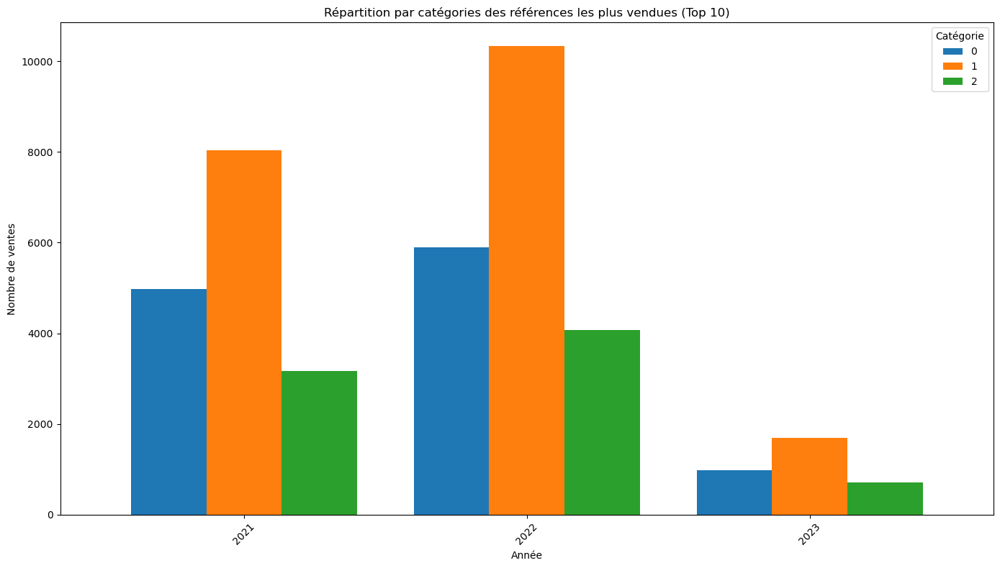

In [98]:
# Grouper les données par année et catégorie, et compter le nombre d'id_prod
grouped_data = top_refs_annee.groupby(['Année', 'categ'])['Ventes'].sum().unstack()

# Création du barplot
fig, ax = plt.subplots(figsize=(14, 8))

# Utiliser plot.bar() pour créer le graphique
grouped_data.plot(kind='bar', ax=ax, width=0.8)

# Personnaliser le graphique
ax.set_xlabel('Année')
ax.set_ylabel('Nombre de ventes')
ax.set_title('Répartition par catégories des références les plus vendues (Top 10)')

# Rotation des étiquettes de l'axe x pour une meilleure lisibilité
plt.xticks(rotation=45)

# Ajuster la légende
ax.legend(title='Catégorie')

# Ajuster l'espacement
plt.tight_layout()

# Afficher le graphique
plt.show()

In [99]:
# Flop des 10 références les moins vendues par années et categories
flop_refs_annee = vente_an.sort_values(by=['Année', 'categ', 'Ventes'],ascending=[True, True, True]).groupby(['Année', 'categ']).head(10).reset_index(drop=True)

# Conserve les lignes ou id prod apparait 2 fois ou plus
flop_refs_annee = flop_refs_annee[flop_refs_annee.duplicated('id_prod',keep=False)]
# Group by 'id_prod' et compte le nombre de lignes
flop_refs_annee2 = flop_refs_annee.groupby('id_prod').size()
# Convertir l'index (id_prod) en liste
list_flop_refs_annee2 = flop_refs_annee2.index.tolist()
print('Références les moins vendues 2 années de suites',list_flop_refs_annee2)

Références les moins vendues 2 années de suites ['0_1032', '0_1116', '1_402', '1_404', '1_408', '1_411', '1_420', '2_103', '2_126', '2_28']


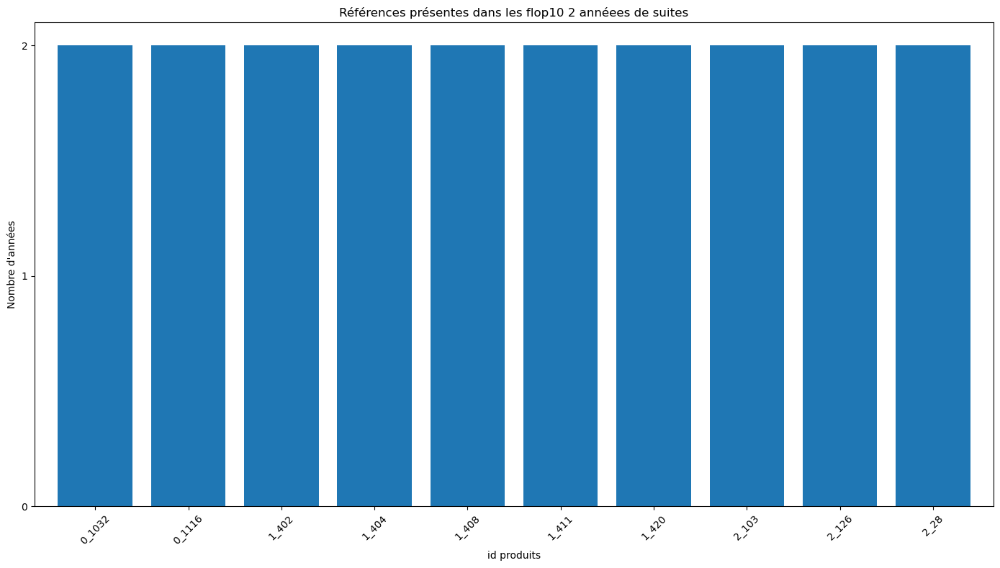

In [100]:
# Création du barplot
fig, ax = plt.subplots(figsize=(14, 8))
# Utiliser plot.bar() pour créer le graphique
flop_refs_annee2.plot(kind='bar', ax=ax, width=0.8)
# Personnaliser le graphique
ax.set_xlabel('id produits')
ax.set_ylabel("Nombre d'années")
ax.set_title('Références présentes dans les flop10 2 annéees de suites')
# Rotation des étiquettes de l'axe x pour une meilleure lisibilité
plt.xticks(rotation=45)
# Définir les graduations de l'axe y comme des entiers
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
# Ajuster l'espacement
plt.tight_layout()
# Afficher le graphique
plt.show()

<div style="display: flex; background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 8 - Etudes des relations demandées
<a class="anchor" id="chapter8"></a>
</div>

-> 5 relations à étudier :

● 8.2 le lien entre le genre d’un client et les catégories des livres achetés,

● 8.3 le lien entre l'âge des clients et le montant total des achats,

● 8.4 le lien entre l'âge des clients et la fréquence d’achat,

● 8.5 le lien entre l'âge des clients et la taille du panier moyen,

● 8.6 le lien entre l'âge des clients et la catégorie des livres achetés

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">8.1 - Préparation de la matrice pour les études des relations demandées </h3>
<a class="anchor" id="section_8_1"></a>
</div>

In [101]:
# Supprimer les colonnes 'Date' et 'Année'
df_lapage = df_lapage.drop(columns=['Date', 'Année','id_prod','date','session_id','price'])

In [102]:
#Création df_R ( df_R pour dataframe Relations)
df_R = df_lapage.copy()
df_R = df_lapage.drop(columns=['categ'])

# Conservez la première occurrence de chaques lignes totalement identiques dans toutes leurs colonnes, ne conservant ainsi que les lignes totalement uniques.
df_R = df_R.drop_duplicates(keep='first')

# Vérification de l'unicité des client_id
Test_client_id_unique = df_R['client_id'].is_unique

print("Tous les client_id sont-ils uniques ?", Test_client_id_unique)

df_R

Tous les client_id sont-ils uniques ? True


,client_id,sex,age,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,Nombre de transactions,Nombre de transactions catégorie 0,Nombre de transactions catégorie 1,Nombre de transactions catégorie 2,Nb_Session,Panier_Moyen
0,c_4410,Femme,57,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,52,26.48
76,c_7839,Femme,49,568.92,227.15,341.77,0.00,37,22.0,15.0,0.0,20,28.45
113,c_1699,Femme,40,190.60,152.44,38.16,0.00,15,13.0,2.0,0.0,6,31.77
128,c_5961,Femme,62,1150.42,331.30,819.12,0.00,76,37.0,39.0,0.0,58,19.83
204,c_5320,Homme,81,396.53,163.87,232.66,0.00,24,12.0,12.0,0.0,18,22.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...
640265,c_7920,Homme,68,1925.15,413.81,1511.34,0.00,104,34.0,70.0,0.0,48,40.11
640369,c_7403,Femme,54,2592.73,549.45,2043.28,0.00,164,55.0,109.0,0.0,123,21.08
640533,c_5119,Homme,50,729.69,334.43,283.54,111.72,47,40.0,6.0,1.0,25,29.19
640580,c_5643,Femme,56,1995.95,459.64,1536.31,0.00,126,44.0,82.0,0.0,95,21.01


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">8.2 - lien entre le genre d’un client et les catégories des livres achetés </h3>
<a class="anchor" id="section_8_2"></a>
</div>

<div style="background-color: black; padding: 20px;font-size: 16px; ">


### <span style="color: #ff69b4">**Variables**</span><br>


- Le genre d'un clients (sexe) : Variable **qualitative**

- Catégories de livres achetées : Variable **qualitative**.<br><br>

**Deux variables Qualitatives**

<div style="background-color: black; padding: 10px; font-size: 16px; ">

Pour étudier le lien entre des variables **Qualitatives** je commence par crée un **tableau de contingence** puis je réalise un **test de Chi_2**
</div>

In [103]:
# choix des colonnes pour l'analyse :
df_R_sex_categ = df_R[['sex','Nombre de transactions catégorie 0',"Nombre de transactions catégorie 1","Nombre de transactions catégorie 2"]]

# Créer un tableau de contingence : Sexe du client et le nombre de transactions par categories de livre
tableau_contingence = df_R_sex_categ.groupby('sex').sum()

# Convertir les colonnes float en type int 
tableau_contingence = tableau_contingence.astype({
    'Nombre de transactions catégorie 0': 'int',
    'Nombre de transactions catégorie 1': 'int',
    'Nombre de transactions catégorie 2': 'int'
})

tableau_contingence.columns = ['catégorie 0', 'catégorie 1', 'catégorie 2']# Changer les noms des colonnes pour les annotations
tableau_contingence

,catégorie 0,catégorie 1,catégorie 2
sex,,,
Femme,200793,115721,16980
Homme,186488,104884,15868


<div style="background-color: black; padding: 20px;font-size: 14px;">

###  <span style="color: #ff69b4">**Test du chi-carré (chi2)**

### <span style="color: #ff69b4">Hypothèses</span><br>

**<span style="color:orange">Hypothèse Nulle (H0)</span>** : Il n'y a pas de lien entre le genre d’un client et les catégories des livres achetés.<br><br>

**<span style="color:orange">Hypothèse Alternative (H1)</span>** : Il existe un lien entre le genre d’un client et les catégories des livres achetés.<br><br>

In [104]:
# Test Chi-2 

c, p, dof, expected = chi2_contingency(tableau_contingence) 

# Calculer la valeur critique du chi-carré pour 95% de confiance
alpha = 0.05
chi2_critique = round(chi2.ppf(1 - alpha, dof),2)

# Afficher les résultats
print("Valeur critique du chi-carré pour un seuil de signification de",alpha,"%","et",dof,"degrés de liberté :",chi2_critique)
print("Statistique du chi-carré :", c)
print("P-valeur :", p,"\n")

# Interprétation de la valeur p
if p < 0.05:
    conclusion = "Nous rejetons l'hypothèse nulle (H0) : Il n'y a pas d'association entre le genre d’un client et les catégories des livres achetés."
else:
    conclusion = "Nous ne rejetons pas l'hypothèse nulle (H0): Il n'y a pas d'association entre le genre d’un client et les catégories des livres achetés."

print(conclusion)

Valeur critique du chi-carré pour un seuil de signification de 0.05 % et 2 degrés de liberté : 5.99
Statistique du chi-carré : 22.66856665178056
P-valeur : 1.1955928116587024e-05 

Nous rejetons l'hypothèse nulle (H0) : Il n'y a pas d'association entre le genre d’un client et les catégories des livres achetés.


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4">**Interprétation des résultats du test de chi2**</span><br>


La p-valeur obtenue 1.195928116587024e-05 est bien inférieure au seuil de significativité (0,05%). <br>

La statistique du chi-carré (22.66...) est superieur a la valeur critique du chi-carré.(5.99)<br><br>

**Nous rejettons l'hypothèse H0 d'indépendance entre le genre et la catégorie, avec un risuqe très minime de se tromper.**<br><br>

**Par conséquent : Il existe un lien entre le genre d'un client et la categories de livres achetés.**

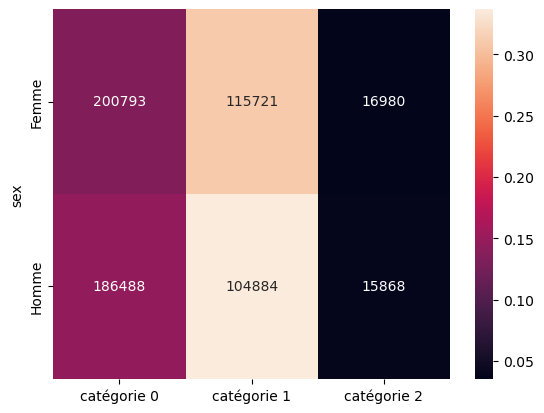

In [105]:
# Création de la Heatmap

# dfmesure ou chaque cellule représente la contribution au chi-carré de la différence entre les valeurs observées et attendues. 
mesure = (tableau_contingence - expected) ** 2 / expected # Utilisation de expected (valeurs attendues du test Chi-2) pour calculer mesure.

table = mesure / c # Normalisations de la mesure en divisant chaque cellule par la statistique du chi-carré.

sns.heatmap(table, annot=tableau_contingence, fmt="d")  #Le paramètre fmt="d" formatte les annotations comme des entiers.
# table représente les couleurs dans la heatmap, montrant les contributions normalisées au chi-carré.
# annot=tableau_contingence représente les chiffres annotés dans chaque cellule de la heatmap, montrant les valeurs observées du tableau de contingence.

plt.show()

<div style="background-color: black; padding: 20px;font-size: 14px;">

### <span style="color: #ff69b4">Analyse de la heatmap</span><br>

La heatmap montre les contributions normalisées
au test du chi-carré pour les transactions 
par sexe et catégories de livres achetées.<br>
On peut considérer cette valeur comme une 
contribution à la non-indépendance entre le genre
 d’un client et les catégories des livres achetés <br>

Plus cette contribution sera proche de 1, 
plus la case en question sera source de non-indépendance <br>

-**La variation des couleurs indique un lien plus important entre le sexe et la catégorie 1.**



<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4">Calculer le coefficient T de Tschuprow</span><br>

Le coefficient T de Tschuprow est une mesure de 
liaison entre deux variables qualitatives.
Il est basé sur le chi-carré (χ²) et prend en compte la
taille de l'échantillon et le nombre de catégories dans chaque variable.<br>

In [106]:


n = tableau_contingence.to_numpy().sum()  # Somme totale des fréquences observées
r = tableau_contingence.shape[0]  # Nombre de lignes dans le tableau de contingence
k = tableau_contingence.shape[1]  # Nombre de colonnes dans le tableau de contingence
# c = Valeurs obtenues du test du chi-carré

# Calcul du coeff T de Tschuprow
T = np.sqrt((c / n) / np.sqrt((r - 1) * (k - 1)))

print(f"Le coefficient T de Tschuprow est {T:.3f}")

Le coefficient T de Tschuprow est 0.005


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

Le coefficient T de Tschuprow varie entre 0 et 1. 
Le coefficient T de Tschuprow calculé est de 0.005, proche de 0 indique une liaison très faible.<br>

### <span style="color: #ff69b4">**Conclusion**</span><br>


-**Les résultats du test de chi2 ont permits de rejeter l'hypothèse nulle H_0 et montré qu'il existe un lien entre le sexe et les catégories de lives achetées**

-**Le coefficient T de Tschuprow obtenu à partir des valeurs du test chi2 montre que ce lien est très faible**



<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">8.3 - Lien entre l'âge des clients et le montant total des achats </h3>
<a class="anchor" id="section_8_3"></a>
</div>

<div style="background-color: black; padding: 20px;font-size: 16px; ">

### <span style="color: #ff69b4">**Variables**</span><br>

- Âge : Variable **quantitative**

- Montant des achats : Variable **quantitative**<br><br>

**Deux variables Quantitatives**

<div style="background-color: black; padding: 10px; font-size: 16px; ">

Pour étudier le lien entre des variables **Quantitatives** je commence par visualiser les données à l'aide d'un **graphique en nuage de points**
</div>

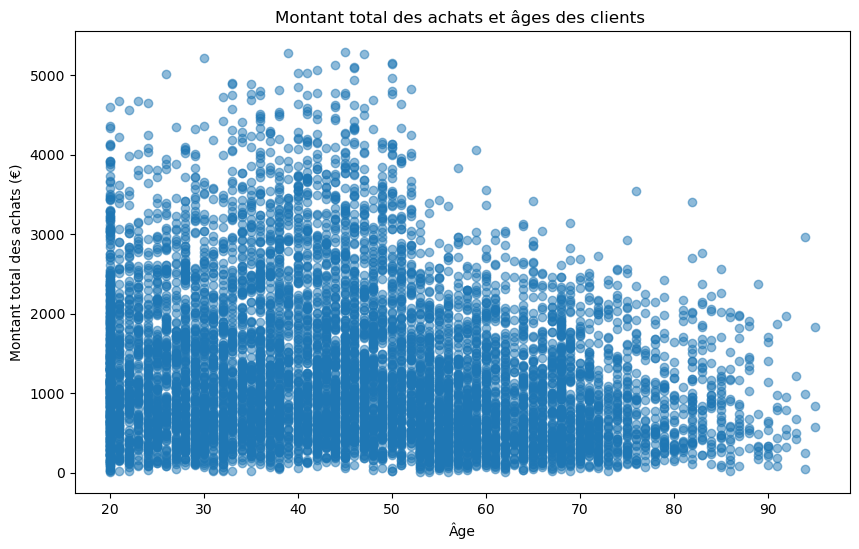

In [107]:
# Scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df_R['age'], df_R['CA_total'], alpha=0.5)
plt.title('Montant total des achats et âges des clients ')
plt.xlabel('Âge')
plt.ylabel('Montant total des achats (€)')
plt.show()


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4">**Analyse graphique du nuage de points**</span><br>

**La tendance générale semble être baissière** Cela pourrait montrer que plus l'âge augmente plus le montant des achats diminue.

**La variaance des montants des achats parait plus grande chez les clients plus jeunes**<br><br>

In [108]:
# calcul du coéff de corrélation de Pearson
pearson_corr, p_value = pearsonr(df_R["age"], df_R["CA_total"])

print("Corrélation de Pearson entre l'âge et le montant total des achats :", round(pearson_corr,2))

corr=abs(pearson_corr) #Conversion du coeff en valeur absolue

if corr > 0.5 :
    conclusion = " - Il existe une corrélation linéaire entre le montant total des achats et l'âge des clients."
else:
    conclusion = " - Il n'existe pas de corrélation linéaire entre le montant total des achats et l'âge des clients."

print("\n",conclusion)

Corrélation de Pearson entre l'âge et le montant total des achats : -0.19

  - Il n'existe pas de corrélation linéaire entre le montant total des achats et l'âge des clients.


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4">**Conclusion**</span><br>

Il n'existe pas de corrélation linéaire entre l'age des client et le mopntant total des achats, par conséquent : 

**Cela indique que l'âge des clients et le montant total des achats ne sont pas liées par une corrélation linaire.**

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">8.4 - Lien entre l'âge des clients et la fréquence d’achat </h3>
<a class="anchor" id="section_8_4"></a>
</div>

<div style="background-color: black; padding: 20px;font-size: 16px; ">

### <span style="color: #ff69b4">**Variables**</span><br>

- Âge : Variable **quantitative**

- Fréquence d'achats : Variable **quantitative**<br><br>

**Deux variables Quantitatives**

<div style="background-color: black; padding: 10px; font-size: 16px; ">

Pour étudier le lien entre des variables **Quantitatives** je commence par visualiser les données à l'aide d'un **graphique en nuage de points**
</div>

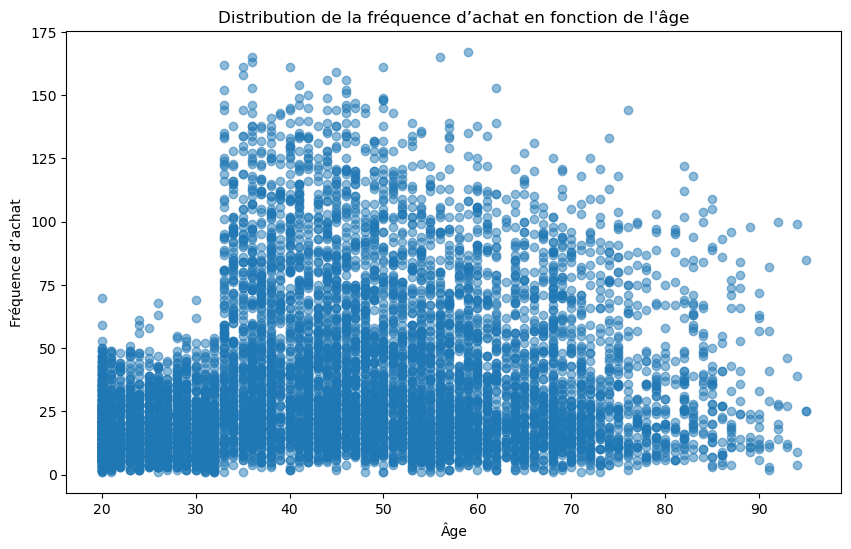

In [109]:
# Scatter plot pour la fréquence d'achat
plt.figure(figsize=(10, 6))
plt.scatter(df_R['age'], df_R['Nb_Session'], alpha=0.5)
plt.title("Distribution de la fréquence d’achat en fonction de l'âge")
plt.xlabel('Âge')
plt.ylabel("Fréquence d’achat")
plt.show()

<div style="background-color: black; padding: 20px;font-size: 14px;">

### <span style="color: #ff69b4">Analyse visuel du nuage de points</span><br>

**Tendance générale :** La tendance de la distribution de la fréquence en fonction de l'age parrait baissière.<br>

**Variabilité :** La variabilité des montants des achats est plus importante apres 33ans

In [110]:
# Calculer la corrélation de Pearson entre l'âge et la fréquence d'achat
pearson_corr, p_value = pearsonr(df_R['age'], df_R['Nb_Session'])

print("Corrélation de Pearson entre l'âge et la fréquence d'achat :", round(pearson_corr,2),"\n")

corr=abs(pearson_corr) #Conversion du coeff en valeur absolue

if corr > 0.5 :
    conclusion = " - Il existe une corrélation linéaire entre la fréquence d'achat et l'age des clients."
else:
    conclusion = " - Il n'existe pas de corrélation linéaire entre la fréquence d'achat et l'age des clients."

print(conclusion)

Corrélation de Pearson entre l'âge et la fréquence d'achat : 0.16 

 - Il n'existe pas de corrélation linéaire entre la fréquence d'achat et l'age des clients.


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4">**Conclusion**</span><br>

Il n'existe pas de corrélation linéaire entre l'age d’un client et la fréquence d'achat, par conséquent : 

**Cela indique que l'âge des clients et la fréquence d'achats ne sont pas liées par une corrélation linaire.**

<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4"> **Discrétiser l'âge en deux groupes : avant et après 33 ans** </span>

</div>

In [111]:
# Discrétiser l'âge en deux groupes : avant et après 33 ans
df_R['age_groupeses'] = pd.cut(df_R['age'], bins=[0, 33, 100], labels=['<= 33 ans', '> 33 ans'])

# Convertir les catégories en type "category" pour éviter les avertissements
df_R['age_groupeses'] = df_R['age_groupeses'].astype('category')

# Afficher les données agrégées pour vérifier
print(df_R.groupby('age_groupeses', observed=True)['Nb_Session'].describe())


                count       mean        std  min   25%   50%   75%    max
age_groupeses                                                            
<= 33 ans      2411.0  20.877229  16.114807  1.0  10.0  17.0  27.0  162.0
> 33 ans       6185.0  43.998545  32.799326  1.0  18.0  34.0  63.0  167.0


<div style="background-color: black; padding: 20px;font-size: 16px; ">


### <span style="color: #ff69b4">**Variables**</span><br>


- Âge (discrétisé) : Après discrétisation, l'âge devient une variable qualitative avec deux niveaux (<= 52 ans et > 52 ans).

- Montant total des achats : Variable quantitative.<br><br>

**Variables Quantitative et Qualitative -> Visualisation à l'aide d'un graphique en boîte à moustache :**

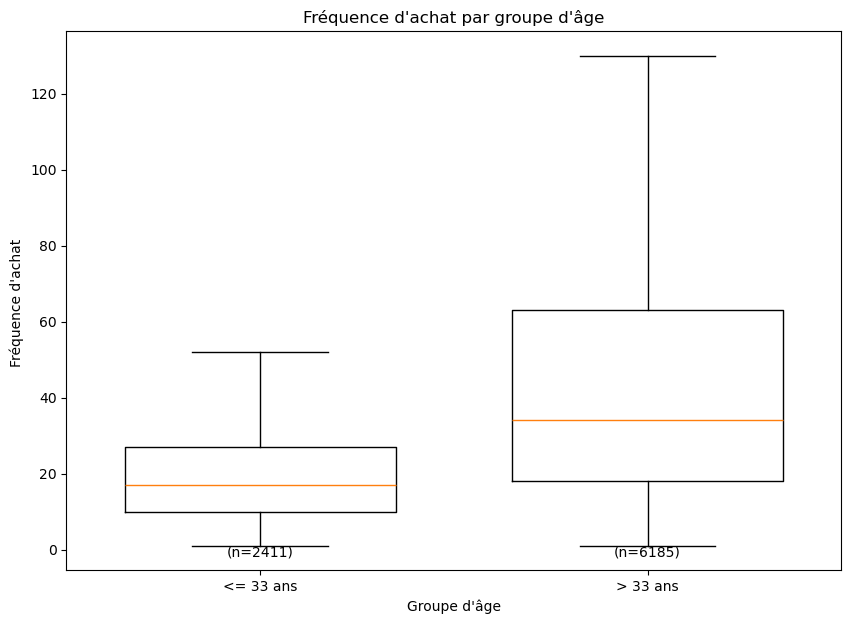

In [112]:
# Visualisation avec un boxplot
groupes = []
for label, group in df_R.groupby('age_groupeses', observed=True):
    frequences = group['Nb_Session']
    if len(frequences) > 0:
        g = {
            'valeurs': frequences,
            'label': label,
            'taille': len(frequences),
            'quartiles': [np.percentile(frequences, p) for p in [25, 50, 75]]
        }
        groupes.append(g)

# Création du boxplot
plt.figure(figsize=(10, 7))
plt.boxplot([g["valeurs"] for g in groupes],
            labels=[g["label"] for g in groupes],
            showfliers=False,  # on ne prend pas en compte les outliers
            widths=0.7)  # largeur graphique des boxplots

# Affichage des effectifs de chaque classe
for i, g in enumerate(groupes):
    plt.text(i + 1, min(g["valeurs"]), "(n={})".format(g["taille"]),
             horizontalalignment='center', verticalalignment='top')

plt.xlabel('Groupe d\'âge')
plt.ylabel('Fréquence d\'achat ')
plt.title('Fréquence d\'achat par groupe d\'âge')
plt.show()

<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 16px;">

### <span style="color: #ff69b4">Analyse visuel des boites à moustaches</span><br>

Le boxplot montre la distribution de la fréquence d'achat pour les deux groupes d'âge.

- Les clients de plus de 33 ans ont une fréquence d'achat médiane plus élevée que ceux de 33 ans ou moins.
- Le groupe d'âge > 33 ans présente une plus grande variabilité dans la fréquence d'achat.
- Le nombre d'observations est plus élevé pour le groupe > 33 ans (n=6185) par rapport au groupe <= 33 ans (n=2411).

**Ces observations indiquent que les clients plus âgés ont tendance à acheter plus fréquemment que les clients plus jeunes.**

Cela pourrait indiquer un lien entre les deux groupes d'age et la fréquence d'achat.<br><br>

### <span style="color: #ff69b4">Hypothèses</span><br>

**<span style="color:orange">Hypothèse Nulle (H0)</span>** : Il n'y a pas de lien entre les deux groupes d'ages et la fréquence d'achat.<br><br>

**<span style="color:orange">Hypothèse Alternative (H1)</span>** : Il existe un Lien entre les deux groupes d'ages et la fréquence d'achat.<br>



In [113]:
# Création d'un tableau ANOVA à un facteur renvoyés pour la somme des carrés de type II 

model = ols('Nb_Session ~ age_groupeses', data = df_R).fit()
aov_table = sm.stats.anova_lm(model, typ=2)

def anova_table(aov):

#Calcul somme des carrés moyen (mean_sq)
    aov['mean_sq'] = aov[:]['sum_sq']/aov[:]['df']

## Calcul du rapport de corrélation eta carré (eta_squared)
    aov['eta_sq'] = aov[:-1]['sum_sq']/sum(aov['sum_sq'])

#Mesurer l'intensité de l'effet avec omega carré (omega squared)
    aov['omega_sq'] = (aov[:-1]['sum_sq']-(aov[:-1]['df']*aov['mean_sq'][-1]))/(sum(aov['sum_sq'])+aov['mean_sq'][-1])

    cols = ['sum_sq', 'df', 'mean_sq', 'F', 'PR(>F)', 'eta_sq', 'omega_sq']
    aov = aov[cols]
    return aov

anova_table(aov_table)

C:\Users\WadJa\AppData\Local\Temp\ipykernel_58632\2210745588.py:15: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



,sum_sq,df,mean_sq,F,PR(>F),eta_sq,omega_sq
age_groupeses,9.273968e+05,1.0,927396.787825,1095.002407,4.019252e-226,0.113015,0.1129
Residual,7.278567e+06,8594.0,846.935844,NaN,NaN,NaN,NaN


<div style="background-color: black; padding: 20px;font-size: 16px;">

### <span style="color: #ff69b4">**Conclusion**</span><br>

Le résultat montre que le rapport de corrélation eta-squared (omega carré) 0.11 : 

Ce niveau de corrélation eta carré, confirmé par oméga carré montre **qu'il n'existe pas de lien entre la fréquence d'achat et les deux groupes d'âges**


<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">8.5 - Lien entre l'âge des clients et la taille du panier moyen </h3>
<a class="anchor" id="section_8_5"></a>
</div>

<div style="background-color: black; padding: 20px;font-size: 16px; ">

### <span style="color: #ff69b4">**Variables**</span><br>

- Âge : Variable **quantitative**

- Taille du panier moyen : Variable **quantitative**<br><br>

**Deux variables Quantitatives**

<div style="background-color: black; padding: 10px; font-size: 16px; ">

Pour étudier le lien entre des variables **Quantitatives** je commence par visualiser les données à l'aide d'un **graphique en nuage de points**
</div>

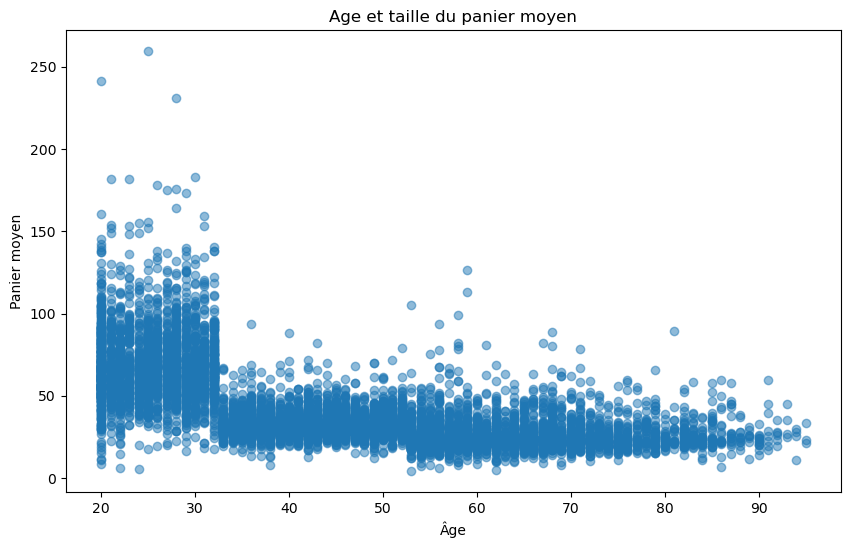

In [114]:
# Variable Quantitative et Quantitative -> Représentation graphique en nuage de point
plt.figure(figsize=(10, 6))
plt.scatter(df_R['age'], df_R['Panier_Moyen'], alpha=0.5)
plt.title('Age et taille du panier moyen')
plt.xlabel('Âge')
plt.ylabel('Panier moyen')
plt.show()


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4">Analyse visuel du nuage de points</span><br>

**Tendance générale :** Il y a une tendance générale parrait baissière mais si ont considère deux deux groupe avant et après 33ans elle parrait stable

**Variabilité :** La variabilité du montant de panier moyen diminue fortement apres à 33ans

**Population de clients :** Le montant du manier moyen parrait supperieur avant 33 ans.<br><br>


In [115]:
# Calculer la corrélation de Pearson et la covariance entre l'âge et la taille du panier moyen
pearson_corr, p_value = pearsonr(df_R['age'], df_R['Panier_Moyen'])

print("Corrélation de Pearson entre l'âge et la taille du panier moyen :", round(pearson_corr,2),"\n")

corr=abs(pearson_corr) #Conversion du coeff en valeur absolue

print("P-value pour la corrélation de Pearson :", p_value,"\n")

# Vérification de l'hypothèse
alpha = 0.05 
if p_value < alpha and corr > 0.5 :
    print("Il existe une corrélation linéaire entre la taille du panier moyenet l'age des clients.")
else:
    print("Il n'existe pas de corrélation linéaire entre la taille du panier moyen et l'age des clients.")


Corrélation de Pearson entre l'âge et la taille du panier moyen : -0.62 

P-value pour la corrélation de Pearson : 0.0 

Il existe une corrélation linéaire entre la taille du panier moyenet l'age des clients.


<div style="background-color: black; padding: 20px;font-size: 16px;">

### <span style="color: #ff69b4">**Conclusion**</span><br>

Nous rejetons l'hypothèse nulle H_0 car il existe un lien de corrélation linéaire entre l'age d’un client et la taille du panier moyen, par conséquent : 

**Cela indique que l'âge des clients et la taille du panier moyen sont liées par une corrélation linéaire.**

<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4"> **Discrétiser l'âge en deux groupes :** </span>

</div>

In [116]:
# Discrétiser l'âge avant et après 33 ans 

df_R.loc[:, 'groupes_ages'] = pd.cut(df_R['age'], bins=[0, 33, 100], labels=['Inf ou égale a 33 ans', 'Suppérieur a 33 ans'])

<div style="background-color: black; padding: 20px;font-size: 16px; ">


### <span style="color: #ff69b4">**Variables**</span><br>


- Âge (discrétisé) : Après discrétisation, l'âge devient une variable qualitative avec deux niveaux ( <=33 ans et >33 ans).

- Taille du panier moyen : Variable quantitative.<br><br>

**Variables Quantitative et Qualitative -> Visualisation à l'aide d'un graphique en boîte à moustache :**

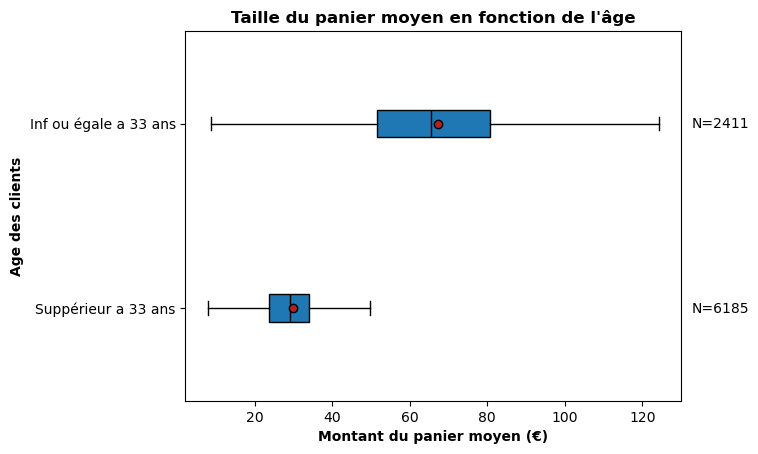

In [117]:
# Visualisation à l'aide d'un graphique en boîte à moustache
 
X = 'groupes_ages'
Y = 'Panier_Moyen'
 
modalites = sorted(df_R[X].unique(), reverse=True) # sorted pour trie les catégories en ordre inverse

groupes = []
for m in modalites:
    groupes.append(df_R[df_R[X]==m][Y])   

# Calculer les effectifs pour chaque groupe
effectifs = [len(g) for g in groupes]

 
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

# Ajouter les effectifs pour chaque groupe
for i, eff in enumerate(effectifs, start=1):
    plt.text(1.02, i, f'N={eff}', va='center', ha='left', transform=plt.gca().get_yaxis_transform())

    
plt.boxplot(groupes, labels=modalites, showfliers=False, medianprops=medianprops, 
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.title("Taille du panier moyen en fonction de l'âge", fontweight='bold', fontsize = 12)
plt.ylabel("Age des clients", fontweight='bold')
plt.xlabel('Montant du panier moyen (€)', fontweight='bold')
plt.show()

<div style="background-color: black; padding: 20px;font-size: 16px; ">

### <span style="color: #ff69b4">Analyse visuel des boites à moustaches</span><br>

Les clients de plus de 33 ans ont une taille de panier moyen globalement plus faible que ceux de 33 ans ou moins.<br>
Le groupe d'âge inf ou égale a 33 ans présente une variabilité plus importante au niveau de la taille du panier moyen.<br>
Le nombre d'observations N est plus élevé pour le groupe > 33 ans (n=6185) par rapport au groupe <= 33 ans (n=2411).<br>

Cela pourrait indiquer un lien entre les deux groupes d'age et la taille du panier moyen.<br><br>

### <span style="color: #ff69b4">Hypothèses</span><br>

**<span style="color:orange">Hypothèse Nulle (H0)</span>** : Il n'y a pas de lien entre les deux groupes d'ages et la taille du panier moyen.<br><br>

**<span style="color:orange">Hypothèse Alternative (H1)</span>** : Il existe un Lien entre les deux groupes d'ages et la taille du panier moyen.<br>


In [118]:
# Création d'un tableau ANOVA à un facteur renvoyés pour la somme des carrés de type II 

model = ols('Panier_Moyen ~ groupes_ages', data = df_R).fit()
aov_table = sm.stats.anova_lm(model, typ=2)

def anova_table(aov):

#Calcul somme des carrés moyen (mean_sq)
    aov['mean_sq'] = aov[:]['sum_sq']/aov[:]['df']

## Calcul du rapport de corrélation eta carré (eta_squared)
    aov['eta_sq'] = aov[:-1]['sum_sq']/sum(aov['sum_sq'])

#Mesurer l'intensité de l'effet avec omega carré (omega squared)
    aov['omega_sq'] = (aov[:-1]['sum_sq']-(aov[:-1]['df']*aov['mean_sq'][-1]))/(sum(aov['sum_sq'])+aov['mean_sq'][-1])

    cols = ['sum_sq', 'df', 'mean_sq', 'F', 'PR(>F)', 'eta_sq', 'omega_sq']
    aov = aov[cols]
    return aov

anova_table(aov_table)

C:\Users\WadJa\AppData\Local\Temp\ipykernel_58632\1507631496.py:15: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



,sum_sq,df,mean_sq,F,PR(>F),eta_sq,omega_sq
groupes_ages,2.423443e+06,1.0,2.423443e+06,10257.16631,0.0,0.544113,0.544031
Residual,2.030490e+06,8594.0,2.362683e+02,NaN,NaN,NaN,NaN


In [119]:
#tester la normalité des résidus : 

shapiro(model.resid)

c:\Users\WadJa\anaconda3\envs\Anaconda_3_12\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 8596.



ShapiroResult(statistic=0.8787907240619794, pvalue=4.6606272107621094e-63)

<div style="background-color: black; padding: 20px;font-size: 16px;">

**Analyse de la normalité des résidus (test de Shapiro)**<br>

Le test est non significatif, W = 0.8787907240619794, p = 4.6606272107621094e-63, ce qui indique que **les résidus sont distribués normalement.**

In [120]:
#Non-homogéneité de la variance (hétéroscédasticité) avec le test de LEVENE) : 

levene(df_R['groupes_ages'] == 'Inf ou égale a 33 ans', df_R['groupes_ages'] == 'Suppérieur a 33 ans')

LeveneResult(statistic=0.0, pvalue=1.0)

<div style="background-color: black; padding: 20px;font-size: 16px;">

LeveneResult(statistic=0.0, pvalue=1.0)

**Le test d'homogénéité des variances de Levene n'est pas significatif.**


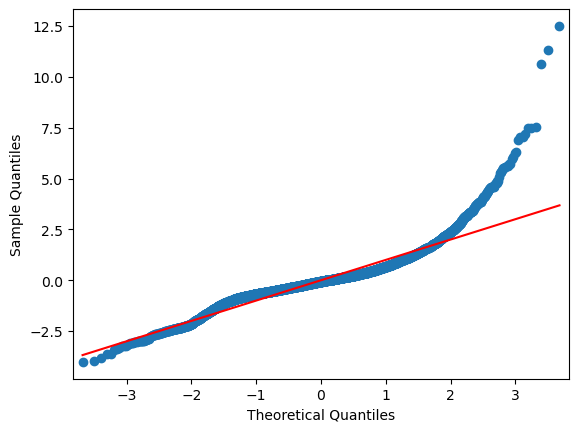

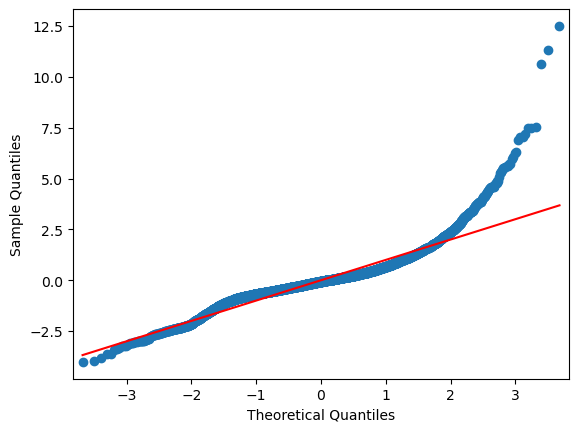

In [121]:
#Crée le diagramme Quantile-Quantile ou diagramme Q-Q plot permettant d'évaluer la pertinence de l'ajustement d'une distribution donnée à un modèle théorique.
pplot = gofplots.ProbPlot(model.resid, fit = True)
pplot.qqplot(line = 's')

<div style="background-color: black; padding: 20px;font-size: 16px;">

### <span style="color: #ff69b4">**Conclusion**</span><br>

Le résultat montre que le rapport de corrélation eta-squared (omega carré) 0.54 : 

-Cela qui indique que 54% de la taille du panier moyen est expliqué par les différences entre les deux catégories d'ages

Ce niveau de corrélation, confirmé par oméga carré montre qu'il existe **un lien entre la taille du panier moyen et les deux groupes d'âges**

La p-value PR(>F) des groupes d'ages (0) indique que nous pouvons rejetez l'hypothèse nulle (H0), confirmant que'il **existe un lien entre l'age des clients et la taille du panier moyen.**

<div style="display: flex; background-color: RGB(255,114,0);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">8.6 - Lien entre l'âge des clients et la catégorie des livres achetés </h3>
<a class="anchor" id="section_8_6"></a>
</div>

<div style="background-color: black; padding: 20px;font-size: 16px; ">


### <span style="color: #ff69b4">**Variables**</span><br>


- Âge : Variable **quantitative**

- Catégories de livres achetées : Variable **qualitative**.<br><br>

**Variables Quantitative et Qualitative**

In [122]:
df_lapage

,client_id,sex,age,categ,CA_total,C.A_catégories 0,C.A_catégories 1,C.A_catégories 2,Nombre de transactions,Nombre de transactions catégorie 0,Nombre de transactions catégorie 1,Nombre de transactions catégorie 2,Nb_Session,Panier_Moyen
0,c_4410,Femme,57,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,52,26.48
1,c_4410,Femme,57,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,52,26.48
2,c_4410,Femme,57,1,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,52,26.48
3,c_4410,Femme,57,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,52,26.48
4,c_4410,Femme,57,0,1376.82,501.56,729.27,145.99,76,38.0,37.0,1.0,52,26.48
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
640729,c_84,Femme,42,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,14,30.54
640730,c_84,Femme,42,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,14,30.54
640731,c_84,Femme,42,1,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,14,30.54
640732,c_84,Femme,42,0,427.51,254.09,173.42,0.00,28,21.0,7.0,0.0,14,30.54


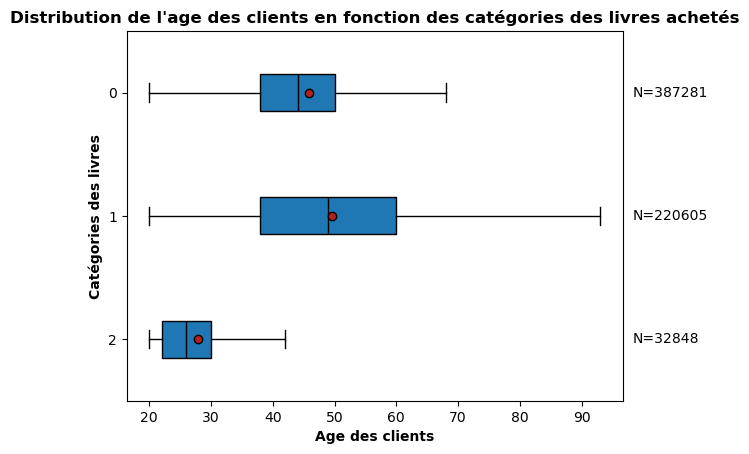

In [123]:
# Visualisation à l'aide d'un graphique en boîte à moustache
 
X = 'categ'
Y = 'age'
 
modalites = sorted(df_lapage[X].unique(), reverse=True) # sorted pour trie les catégories en ordre inverse

groupes = []
for m in modalites:
    groupes.append(df_lapage[df_lapage[X]==m][Y])   

# Calculer les effectifs pour chaque groupe
effectifs = [len(g) for g in groupes]

 
medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}

# Ajouter les effectifs pour chaque groupe
for i, eff in enumerate(effectifs, start=1):
    plt.text(1.02, i, f'N={eff}', va='center', ha='left', transform=plt.gca().get_yaxis_transform())

    
plt.boxplot(groupes, labels=modalites, showfliers=False, medianprops=medianprops, 
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.title("Distribution de l'age des clients en fonction des catégories des livres achetés", fontweight='bold', fontsize = 12)
plt.ylabel("Catégories des livres", fontweight='bold')
plt.xlabel('Age des clients', fontweight='bold')
plt.show()

<div style="background-color: black; padding: 20px;font-size: 16px; ">


### <span style="color: #ff69b4">Analyse visuel des boites à moustaches</span><br>

La distribution de l'âge des acheteurs varie selon la catégorie, 
cela pourrait laisser suggérer que différentes catégories de livres sont préférées par des groupes d'âge distincts.

### <span style="color: #ff69b4">**Hypothèses**</span><br><br>

**<span style="color:orange">Hypothèse Nulle (H0)</span>** : Il n'y a pas de lien entre l'âge des clients et la catégorie des livres achetés.<br><br>

**<span style="color:orange">Hypothèse Alternative (H1)</span>** : Il existe un lien entre l'âge des clients et la catégorie des livres achetés.<br><br>

In [124]:
# ANOVA
 
X = "categ"
Y = "age"
 
def eta_squared(x,y):
    moyenne_y = y.mean()
    classes = []
    for classe in x.unique():
        yi_classe = y[x==classe]
        classes.append({'ni': len(yi_classe),
                        'moyenne_classe': yi_classe.mean()})
    SCT = sum([(yj-moyenne_y)**2 for yj in y])
    SCE = sum([c['ni']*(c['moyenne_classe']-moyenne_y)**2 for c in classes])
    return SCE/SCT
   
print("Le rapport de corrélation vaut", round(eta_squared(df_lapage[X],df_lapage[Y]), 2))
 

Le rapport de corrélation vaut 0.11


<div style="background-color: black; padding: 20px;font-size: 16px;">

### <span style="color: #ff69b4">**Conclusion**</span><br>

Le résultat du test ANOVA montre que le rapport de corrélation (eta-squared) 0.11 : 

-Cela qui indique que 11% de la variabilité de l'âge est expliquée par les différences entre les catégories de livres. 

Ce niveau de corrélation suggère **qu'il n'y a pas d'association entre l'âge des clients et les catégories de livres qu'ils achètent.**

<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 16px;">

### <span style="color: #ff69b4"> **Visualisation du nombre de transactions par categories en fonction de  de l'age** </span>

</div>

<div style="background-color: black; padding: 20px;font-size: 16px; ">


### <span style="color: #ff69b4">**Variables**</span><br>


- Âge : Variable quantitavive 

- Nombre de transactions : Variable quantitative.<br><br>

**Variables Quantitatives -> Visualisation à l'aide d'un nuage de point ou graphique en ligne :**

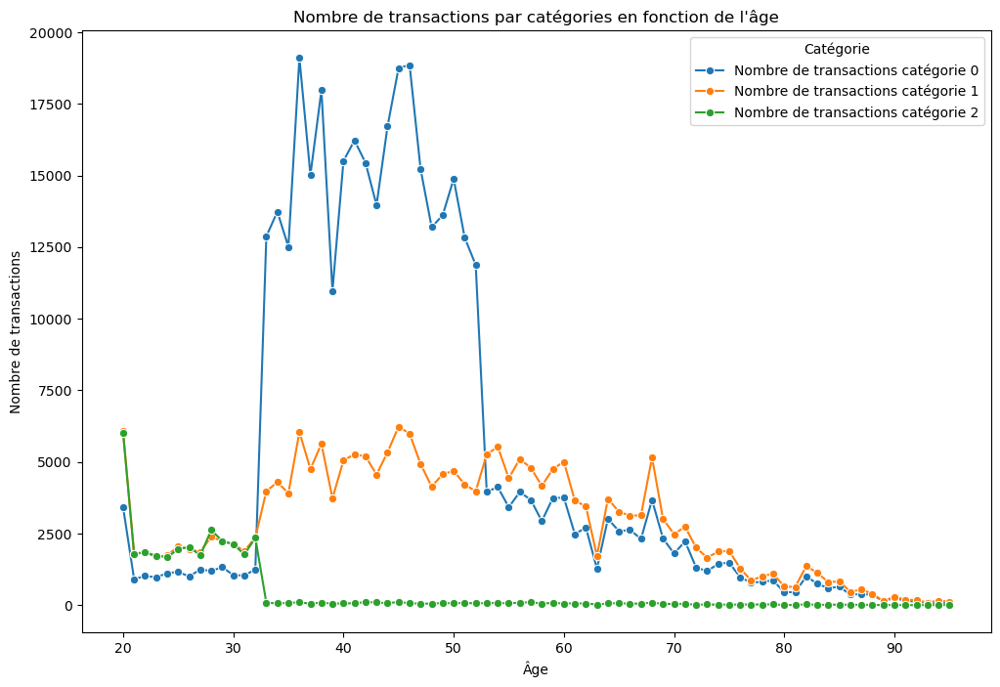

In [125]:
# Préparation de la matrice pour crée un tableau de contingence :
df_R_age_categ = df_R[['age','Nombre de transactions catégorie 0',"Nombre de transactions catégorie 1","Nombre de transactions catégorie 2"]]

# Créer un tableau de contingence : Age du client et le nombre de transactions par categories de livres achetées
tableau_contingence = df_R_age_categ.groupby('age').sum()

# Convertir les colonnes float en type int
tableau_contingence = tableau_contingence.astype({
    'Nombre de transactions catégorie 0': 'int',
    'Nombre de transactions catégorie 1': 'int',
    'Nombre de transactions catégorie 2': 'int'
})

# Transposer le tableau pour avoir les catégories à la verticale
tableau_transpose = tableau_contingence.T

# Convertir le tableau transposé en DataFrame
df_transpose = tableau_transpose.reset_index().melt(id_vars='index', var_name='age', value_name='Nb_transactions')
df_transpose.rename(columns={'index': 'category'}, inplace=True)

# Afficher la représentation graphique du nombre de transaction des trois catégories en fonction de l'âge
plt.figure(figsize=(12, 8))
sns.lineplot(data=df_transpose, x='age', y='Nb_transactions', hue='category', marker='o')
plt.title('Nombre de transactions par catégories en fonction de l\'âge')
plt.xlabel('Âge')
plt.ylabel('Nombre de transactions')
plt.legend(title='Catégorie')
plt.show()


<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4"> **Discrétiser l'âge en deux groupes : Avant et apres 33ans :** </span>

</div>

In [126]:
# Discrétiser l'âge en deux groupes : avant et après 33 ans
df_R['age_groupes'] = pd.cut(df_R['age'], bins=[0, 33, 100], labels=['<= 33 ans', '> 33 ans'])

<div style="background-color: black; padding: 20px;margin-bottom: 30px;font-size: 14px;">

### <span style="color: #ff69b4"> **effectuer une analyse de Variance (ANOVA) avec les deux groupes d'age identifié pour effectuer une analyse de Variance (ANOVA)** </span>

</div>

In [127]:
# Créer un tableau de contingence avec les groupes d'âge et les catégories de transactions
tableau_contingence_age_categ = df_R.groupby('age_groupes', observed=True)[['Nombre de transactions catégorie 0', 'Nombre de transactions catégorie 1', 'Nombre de transactions catégorie 2']].sum().reset_index()

tableau_contingence_age_categ

,age_groupes,Nombre de transactions catégorie 0,Nombre de transactions catégorie 1,Nombre de transactions catégorie 2
0,<= 33 ans,29565.0,33963.0,29962.0
1,> 33 ans,357716.0,186642.0,2886.0


In [128]:
# Groupes d'âge pour l'analyse ANOVA
groupe1 = tableau_contingence_age_categ[tableau_contingence_age_categ['age_groupes'] == '<= 33 ans'][['Nombre de transactions catégorie 0', 'Nombre de transactions catégorie 1', 'Nombre de transactions catégorie 2']].values.flatten()
groupe2 = tableau_contingence_age_categ[tableau_contingence_age_categ['age_groupes'] == '> 33 ans'][['Nombre de transactions catégorie 0', 'Nombre de transactions catégorie 1', 'Nombre de transactions catégorie 2']].values.flatten()

# Test ANOVA
f_stat, p_value_anova = scipy.stats.f_oneway(groupe1, groupe2)

print("F-statistic:", f_stat)
print("P-value:", p_value_anova)

# Conclusion
alpha = 0.05
if p_value_anova < alpha:
    print("Nous rejetons l'hypothèse nulle (H0). Il n'éxiste pas de lien entre l'âge des clients et les categories de livres acheters.")
else:
    print("Nous ne pouvons pas rejeter l'hypothèse nulle (H0). Il éxiste un lien entre l'âge des clients et les categories de livres acheters.")


F-statistic: 2.1790766586542367
P-value: 0.21394097515852772
Nous ne pouvons pas rejeter l'hypothèse nulle (H0). Il éxiste un lien entre l'âge des clients et les categories de livres acheters.


<div style="background-color: black; padding: 20px; margin-bottom: 30px; font-size: 16px;">
<span style="color: #ff69b4">Analyse des résultats de l'ANOVA</span><br><br>
Tableau de contingence<br>
Le tableau de contingence présente le nombre de transactions par catégorie pour les deux groupes d'âge (<= 33 ans et > 33 ans). Les résultats montrent que :<br><br>

Les clients de plus de 33 ans ont un nombre total de transactions (pour toutes les catégories combinées) plus élevé que ceux de 33 ans ou moins.<br><br>
Résultats de l'ANOVA<br>
F-statistic : 2.179876858542367<br>
P-value : 0.21394997515852772<br><br>
Interprétation des résultats de l'ANOVA<br>
La p-value obtenue (0.21394997515852772) est supérieure au seuil de signification de 0.05. Par conséquent, nous ne pouvons pas rejeter l'hypothèse nulle (H0).<br><br>

Conclusion :<br>
Il n'y a pas de différence significative dans les moyennes des transactions entre les groupes d'âge (<= 33 ans et > 33 ans) pour les différentes catégories de produits.<br>
Cela signifie que l'âge des clients n'a pas un effet significatif sur le nombre moyen de transactions par catégorie de produit.

</div>